In [1]:
import os
os.chdir("../")
with open('run/settings.py', 'r') as file:
    exec(file.read())

Random seed set to 333
using device:  cuda


# Configuration (customizable)

In [2]:
overwrite = True
with open('run/configs/synthetic_w_gt.py', 'r') as file:
    exec(file.read())

update_config(model_name = 'syn_gt_resdiff',
              custom_target_cols = ['label'])
config_dict = get_config_dict()

# Data

In [3]:
# change data preparation for a given experiment
with open('run/prepare_datasets/synthetic.py', 'r') as file:
    exec(file.read())
# prepare model inputs
with open('run/inputs.py', 'r') as file:
    exec(file.read())

{'No trend.': (210, 60, 30), 'The time series shows upward linear trend.': (210, 60, 30), 'The time series shows downward linear trend.': (210, 60, 30), 'The time series shows upward quadratic trend.': (210, 60, 30), 'The time series shows downward quadratic trend.': (210, 60, 30), 'No seasonal pattern.': (210, 60, 30), 'The time series exhibits a seasonal pattern.': (210, 60, 30), 'No sharp shifts.': (210, 60, 30), 'The mean of the time series shifts upwards.': (210, 60, 30), 'The mean of the time series shifts downwards.': (210, 60, 30), 'The time series exhibits low variability.': (210, 60, 30), 'The time series exhibits high variability.': (210, 60, 30)}


final distribution of text prediction
text
No trend. No seasonal pattern. No sharp shifts. The time series exhibits low variability.                                                                                                210
No trend. No seasonal pattern. No sharp shifts. The time series exhibits high variability.         

# Model (customizable)

In [12]:

class DiffusionRefiner(nn.Module):
    """
    Lightweight denoising refiner that improves ts_hat using iterative residual steps.
    Mimics diffusion-style denoising by progressively refining x₀ + noise.
    """
    def __init__(self, ts_dim, txt_dim, hidden_dim, n_steps=4):
        super().__init__()
        self.n_steps = n_steps
        self.txt_proj = nn.Linear(txt_dim, ts_dim)  # project text to match ts_dim

        self.step_blocks = nn.ModuleList([
            nn.Sequential(
                nn.Linear(ts_dim * 2, hidden_dim),  # [x || txt_emb_projected]
                nn.GELU(),
                nn.Linear(hidden_dim, ts_dim)
            )
            for _ in range(n_steps)
        ])

    def forward(self, coarse_ts: torch.Tensor, txt_emb: torch.Tensor):
        """
        Args:
            coarse_ts: [B, ts_dim]  - coarse output from main decoder
            txt_emb:   [B, txt_dim] - text embedding
        Returns:
            refined_ts: [B, ts_dim]
        """
        x = coarse_ts + torch.randn_like(coarse_ts) * 0.1  # add noise

        txt_emb_proj = self.txt_proj(txt_emb)  # [B, ts_dim]

        for block in self.step_blocks:
            h = torch.cat([x, txt_emb_proj], dim=-1)  # [B, 2 * ts_dim]
            dx = block(h)
            x = x - dx  # residual denoising

        return x


class ResAttDiffDecoder(nn.Module):
    """
    Residual-attention decoder with optional diffusion denoising tail.
    Produces a coarse prediction and optionally refines it with learned noise steps.
    """
    def __init__(
        self,
        ts_dim: int,
        output_dim: int,
        nhead: int = 8,
        num_layers: int = 6,
        dim_feedforward: int = 1024,
        dropout: float = 0.1,
        project_input: bool = False,
        diffusion_steps: int = 10,  # if > 0, apply diffusion tail
    ):
        super().__init__()
        hidden_dim = output_dim
        self.diffusion_steps = diffusion_steps

        self.project_input = project_input
        if self.project_input:
            self.proj_ts = nn.Linear(output_dim, ts_dim)
            self.proj_text = nn.Linear(output_dim, ts_dim)
            hidden_dim = ts_dim

        self.pos_encoder = PositionalEncoding(hidden_dim)

        self.blocks = nn.Sequential(*[
            ResidualAttentionBlock(
                width=hidden_dim,
                heads=nhead,
                ffn_mult=dim_feedforward // hidden_dim,
                drop=dropout
            ) for _ in range(num_layers)
        ])

        self.out = nn.Sequential(
            nn.LayerNorm(hidden_dim),
            nn.Linear(hidden_dim, ts_dim)
        )

        # Optional diffusion tail
        if diffusion_steps > 0:
            self.diffusion_tail = DiffusionRefiner(
                ts_dim=ts_dim,
                txt_dim=hidden_dim,
                hidden_dim=hidden_dim,
                n_steps=diffusion_steps
            )

    @staticmethod
    def _as_sequence(x: torch.Tensor) -> torch.Tensor:
        return x.unsqueeze(1) if x.dim() == 2 else x  # [B, 1, E]

    def forward(self, ts_emb: torch.Tensor, txt_emb: torch.Tensor, refine: bool = True):
        B = ts_emb.size(0)

        tgt    = self._as_sequence(ts_emb)
        memory = self._as_sequence(txt_emb)

        if self.project_input:
            tgt    = self.proj_ts(tgt)
            memory = self.proj_text(memory)

        tokens = torch.cat([tgt, memory], dim=1)  # [B, 2, hidden_dim]
        tokens = self.pos_encoder(tokens)

        h = self.blocks(tokens)
        ts_hat = self.out(h[:, 0])  # [B, ts_dim]

        if self.diffusion_steps > 0 and refine:
            ts_hat = self.diffusion_tail(ts_hat, txt_emb)

        return ts_hat.unsqueeze(1)  # [B, 1, ts_dim]



In [15]:
ts_decoder = ResAttDiffDecoder(ts_dim=ts_f_dim.shape[1], 
                                          output_dim=config_dict['embedded_dim'],
                                          nhead = 8,
                                          num_layers = 3,
                                          dim_feedforward= 768).to(device)
with open('run/model.py', 'r') as file:
    exec(file.read())


Layer (type:depth-idx)                                                 Param #
VITAL                                                                  --
├─TSEncoder: 1-1                                                       --
│    └─LocalNorm: 2-1                                                  --
│    └─MultiCNNEncoder: 2-2                                            768
│    │    └─ModuleList: 3-1                                            3,691,408
│    │    └─MultiheadAttention: 3-2                                    2,362,368
│    │    └─LayerNorm: 3-3                                             1,536
├─TextEncoder: 1-2                                                     --
│    └─TextEncoderAttention: 2-3                                       768
│    │    └─MultiheadAttention: 3-4                                    2,362,368
│    │    └─Linear: 3-5                                                590,592
│    │    └─GELU: 3-6                                                  --
│ 

# Train

Epoch [1/10000]
	Training Loss: 7.411185 (clip: 5.867693, rc: 1.543493, kl: 0.000000)
	Testing Loss: 6.253605 (clip: 5.281380, rc: 0.972225, kl: 0.000000)
	Learning Rate: 0.000100000
alpha: 0.001, beta: 0.0
----------------------------------------------------------------------------------------------------

Recalibrating alpha to: 1.00e-04
----------------------------------------------------------------------------------------------------
Epoch [11/10000]
	Training Loss: 5.982907 (clip: 5.481518, rc: 0.501389, kl: 0.000000)
	Testing Loss: 5.556624 (clip: 5.073307, rc: 0.483317, kl: 0.000000)
	Learning Rate: 0.000100000
alpha: 0.0001, beta: 0.0
Epoch [21/10000]
	Training Loss: 5.416046 (clip: 5.365300, rc: 0.050746, kl: 0.000000)
	Testing Loss: 5.031482 (clip: 4.982889, rc: 0.048592, kl: 0.000000)
	Learning Rate: 0.000100000
alpha: 0.0001, beta: 0.0
Epoch [31/10000]
	Training Loss: 5.404598 (clip: 5.355994, rc: 0.048603, kl: 0.000000)
	Testing Loss: 5.021495 (clip: 4.970688, rc: 0.05080

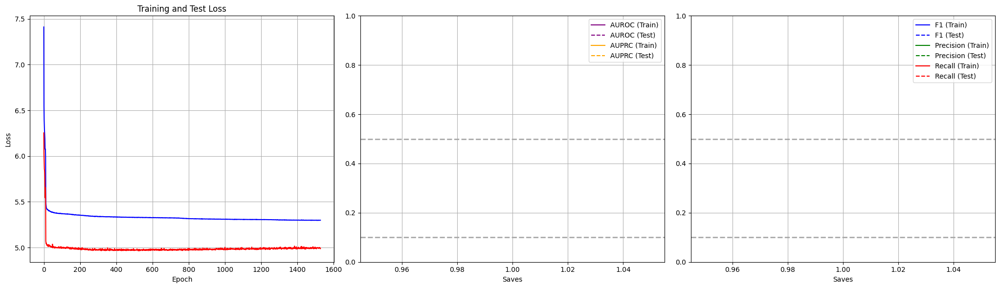

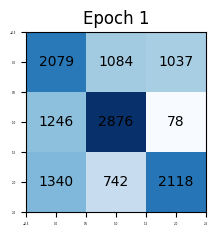

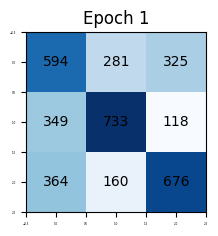

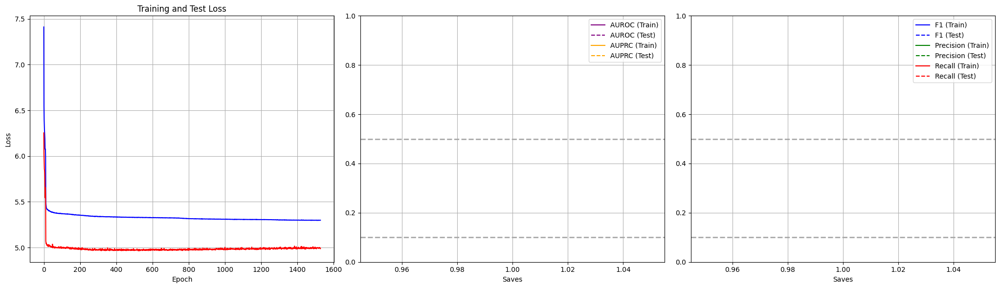

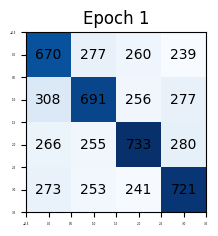

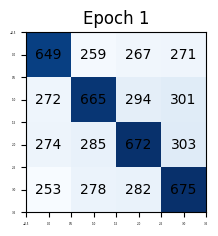

KeyboardInterrupt: 

In [16]:
with open('run/train.py', 'r') as file:
    exec(file.read())


# Generation

100    No trend.
Name: segment1, dtype: object


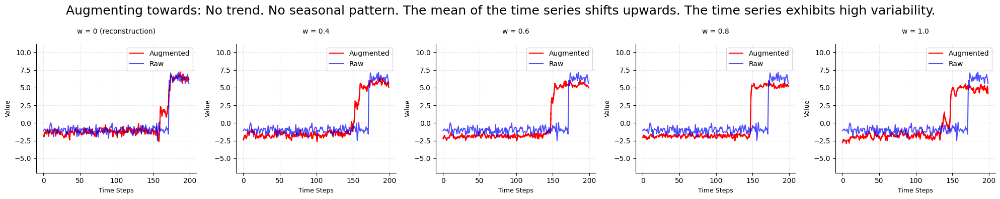

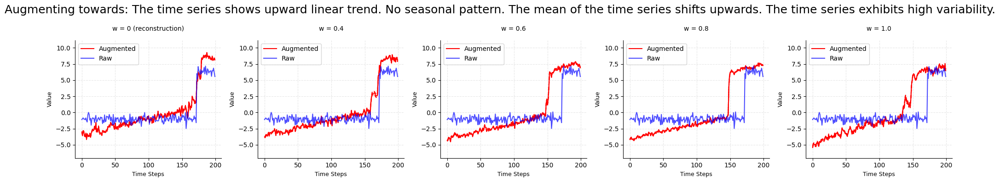

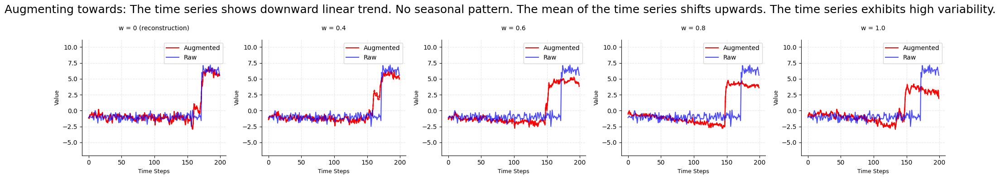

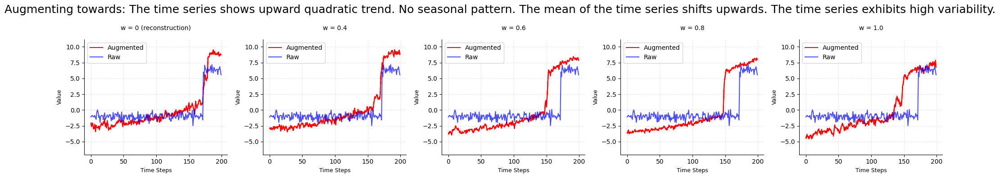

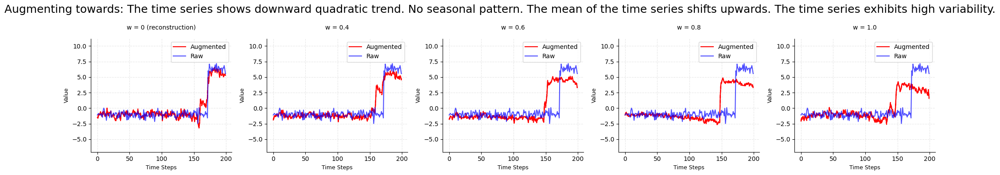

100    The time series shows upward linear trend.
Name: segment1, dtype: object


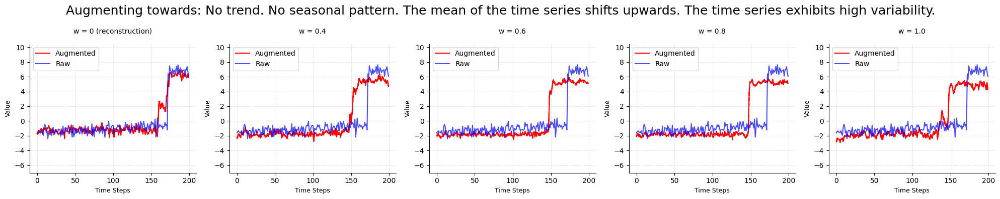

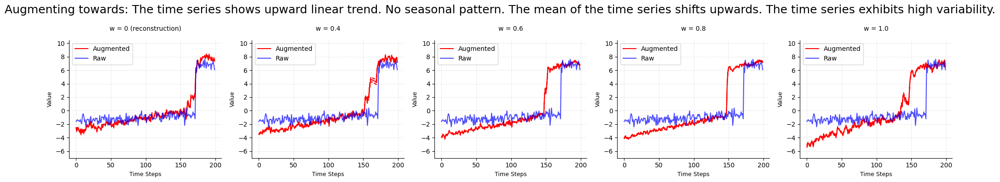

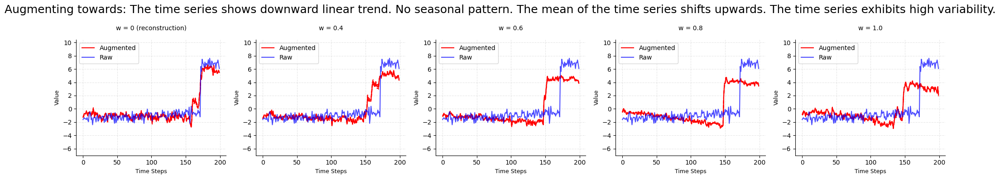

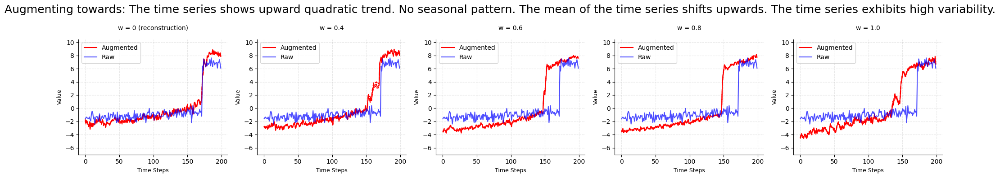

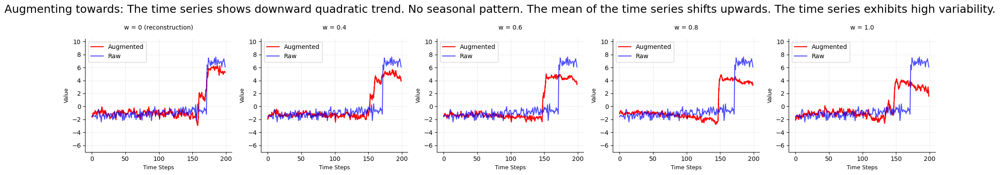

100    The time series shows downward linear trend.
Name: segment1, dtype: object


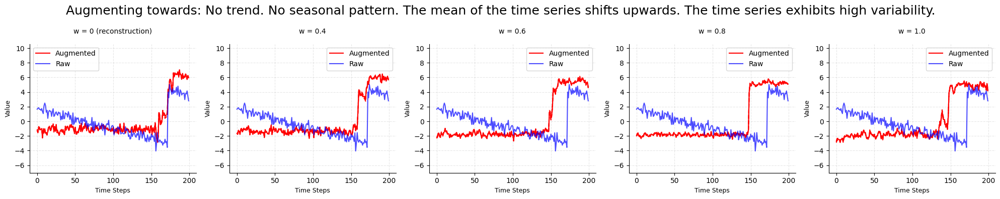

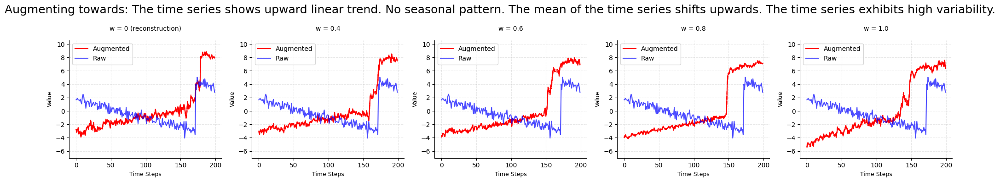

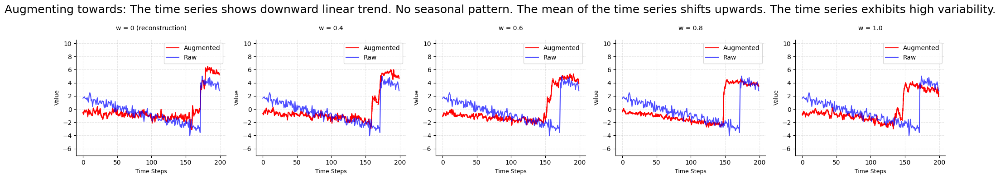

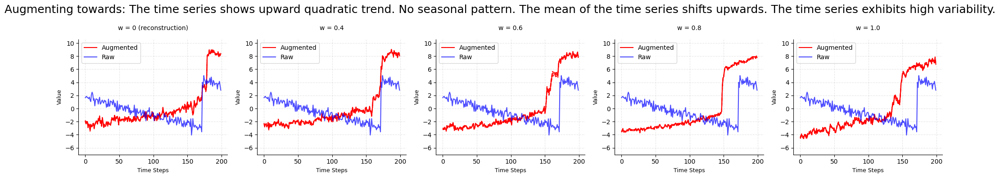

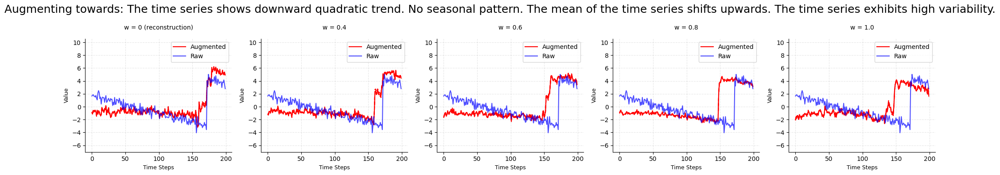

100    The time series shows upward quadratic trend.
Name: segment1, dtype: object


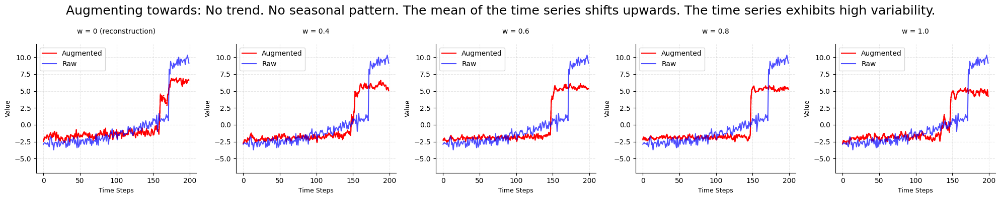

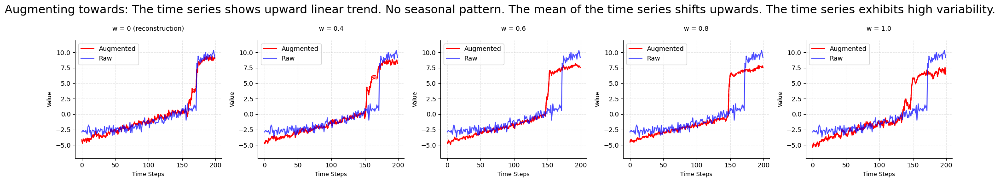

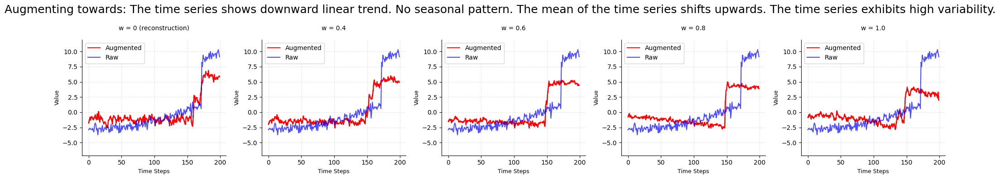

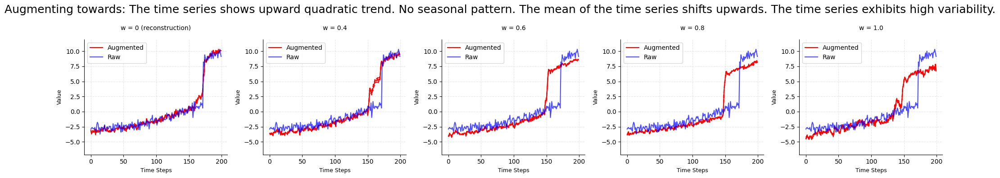

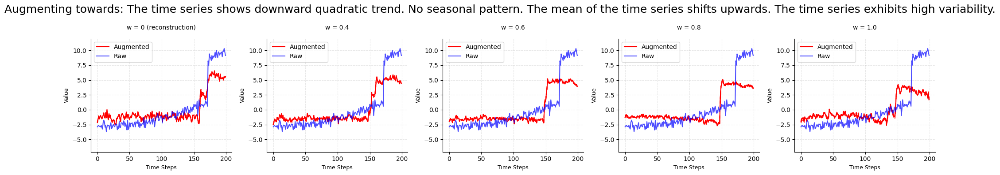

100    The time series shows downward quadratic trend.
Name: segment1, dtype: object


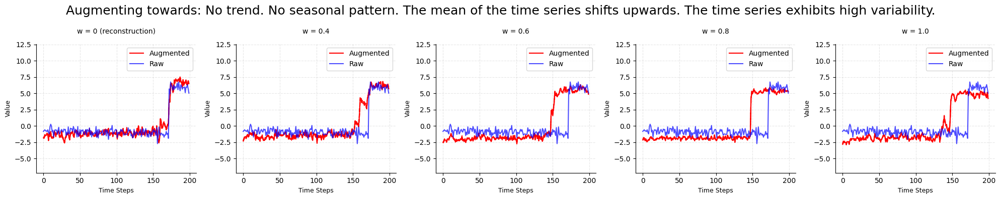

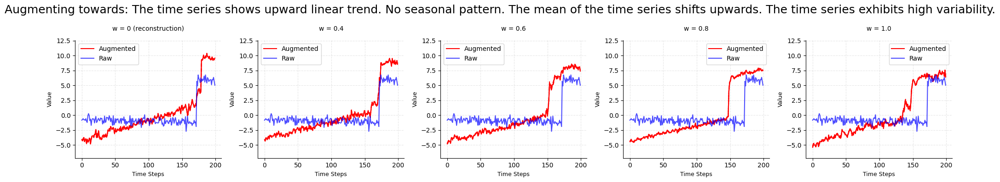

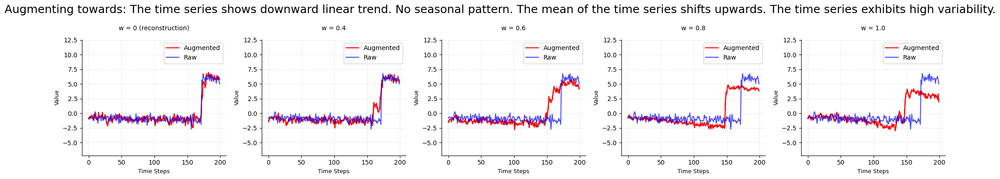

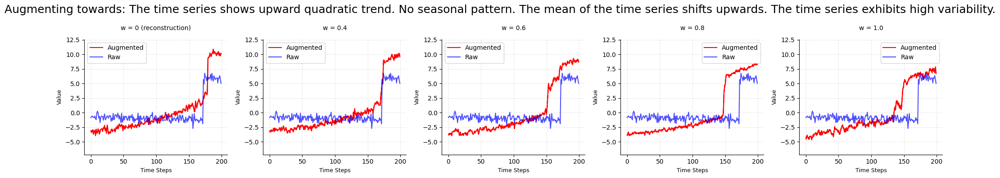

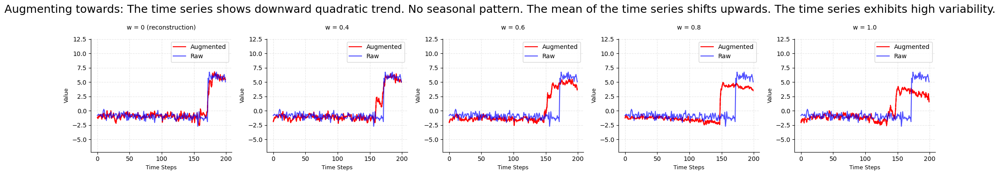

100    No seasonal pattern.
Name: segment2, dtype: object


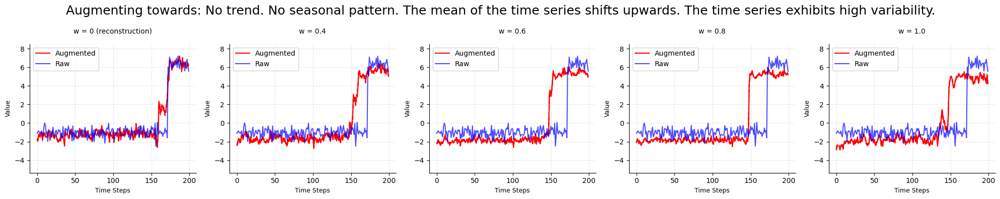

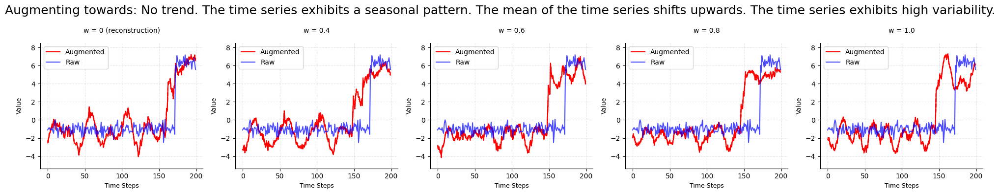

100    The time series exhibits a seasonal pattern.
Name: segment2, dtype: object


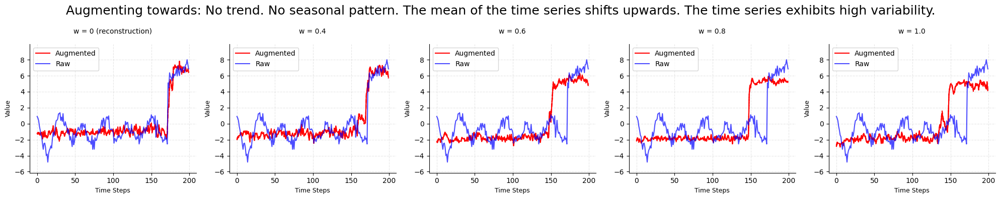

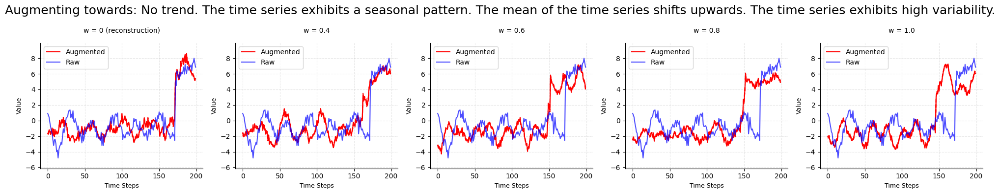

100    No sharp shifts.
Name: segment3, dtype: object


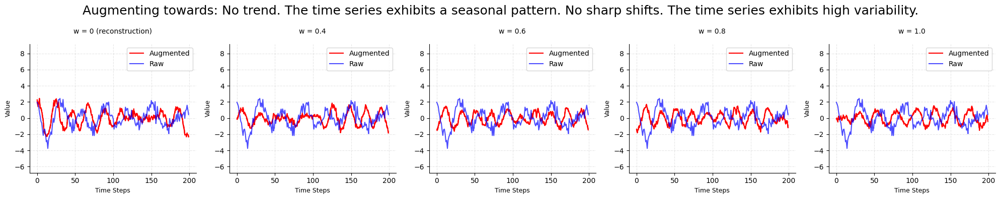

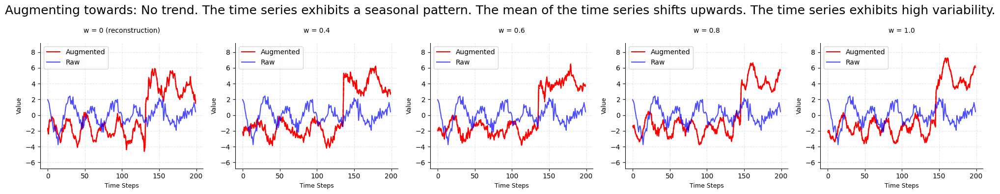

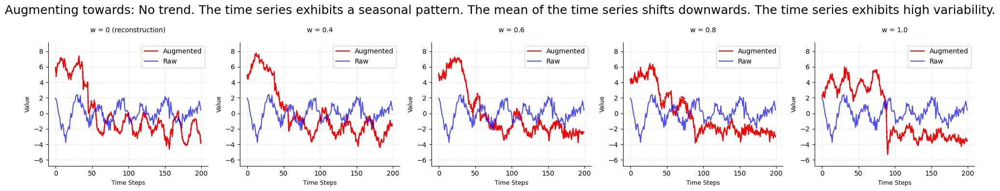

100    The mean of the time series shifts upwards.
Name: segment3, dtype: object


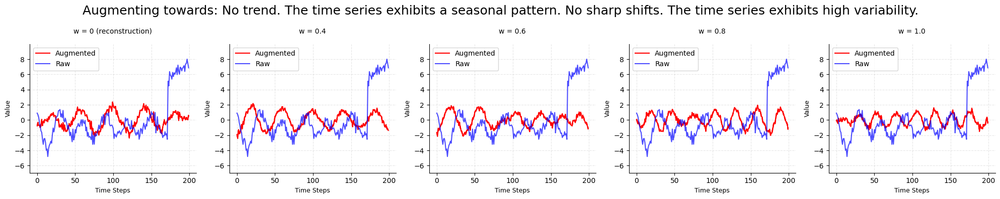

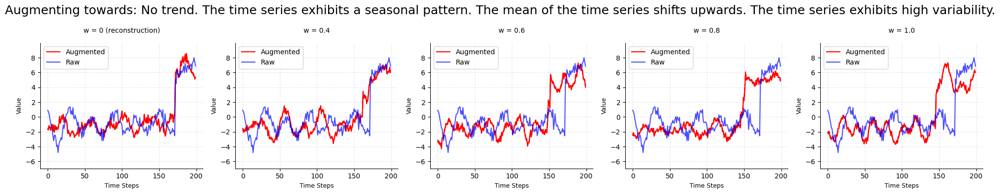

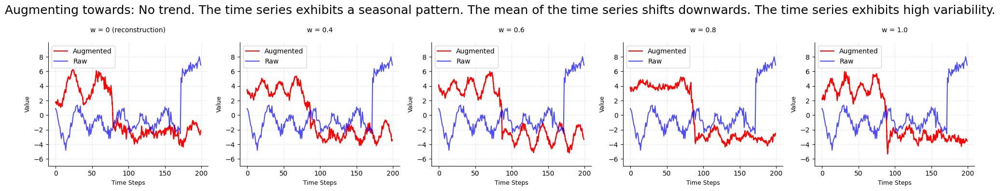

100    The mean of the time series shifts downwards.
Name: segment3, dtype: object


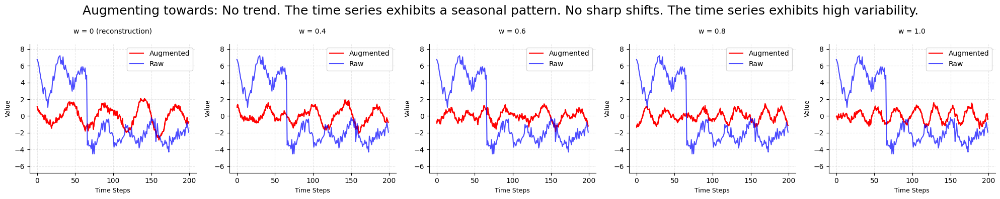

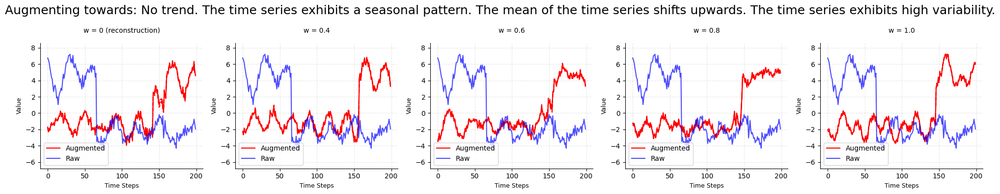

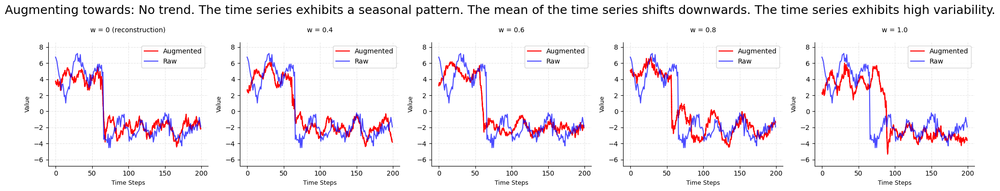

100    The time series exhibits low variability.
Name: segment4, dtype: object


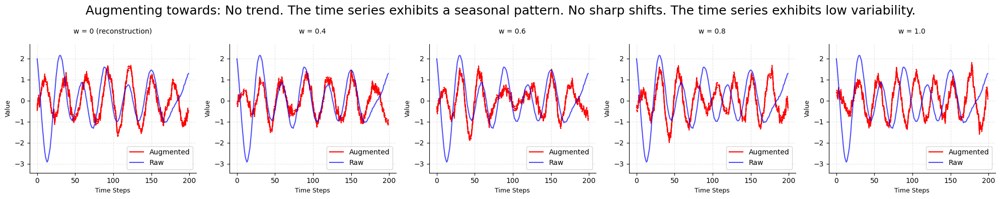

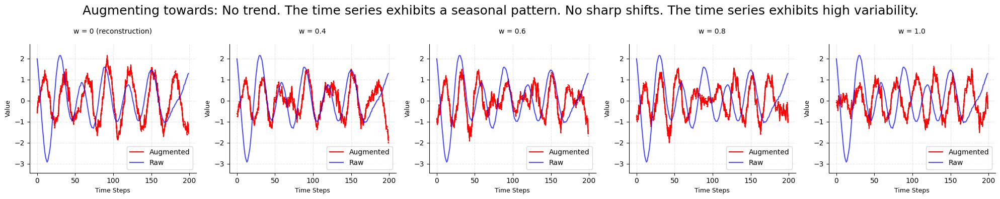

100    The time series exhibits high variability.
Name: segment4, dtype: object


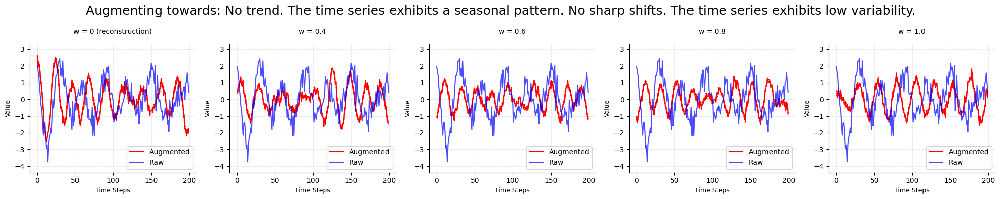

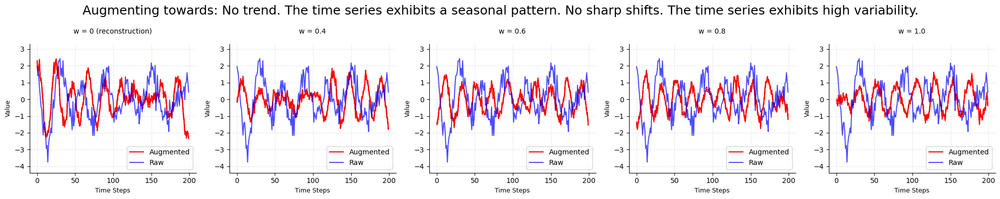

In [17]:
tid=100
# viz_generation_marginal(df_train, model, config_dict, tid=tid)
viz_generation_conditional(df_left, model, config_dict, tid=tid, sampling=True, b=100, ep=1)

100%|██████████| 2/2 [00:04<00:00,  2.42s/it]


segment1


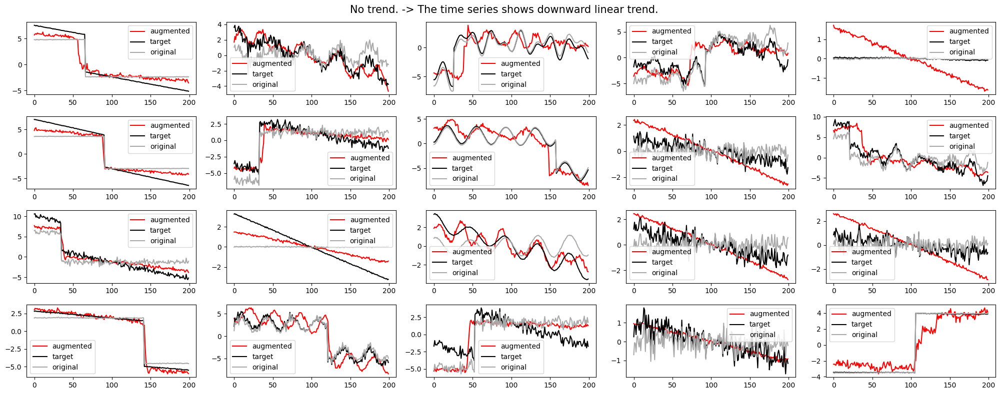

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2316.33it/s]


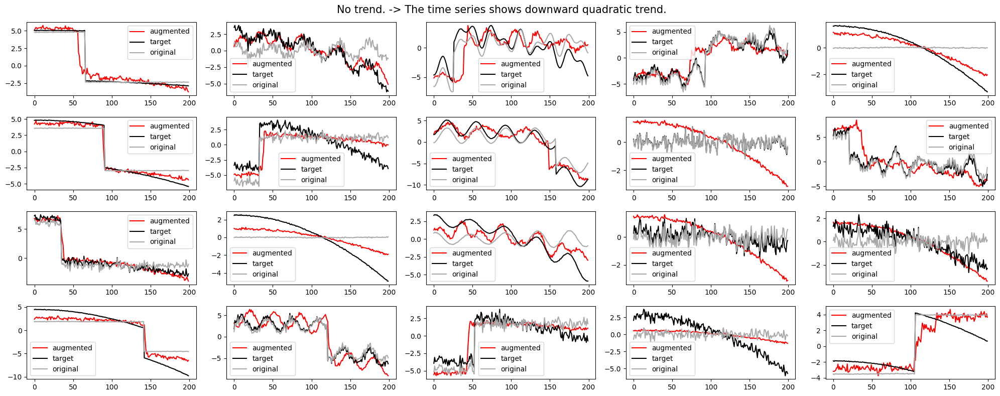

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2333.68it/s]


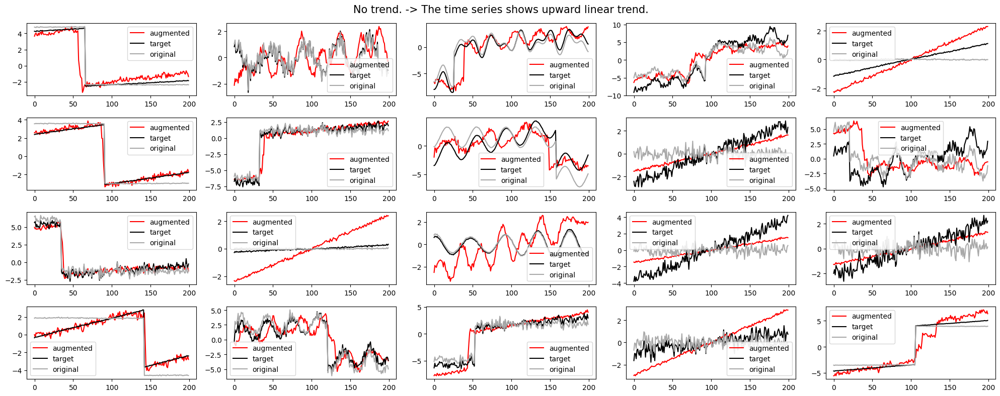

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2275.51it/s]


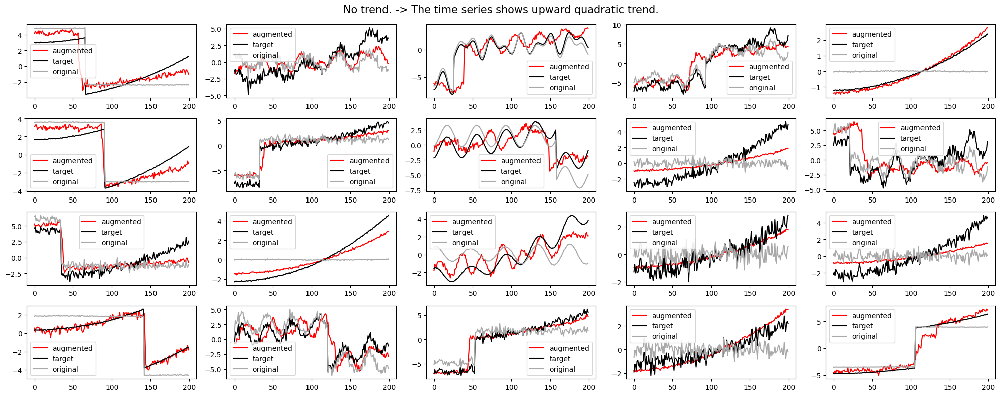

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2405.41it/s]


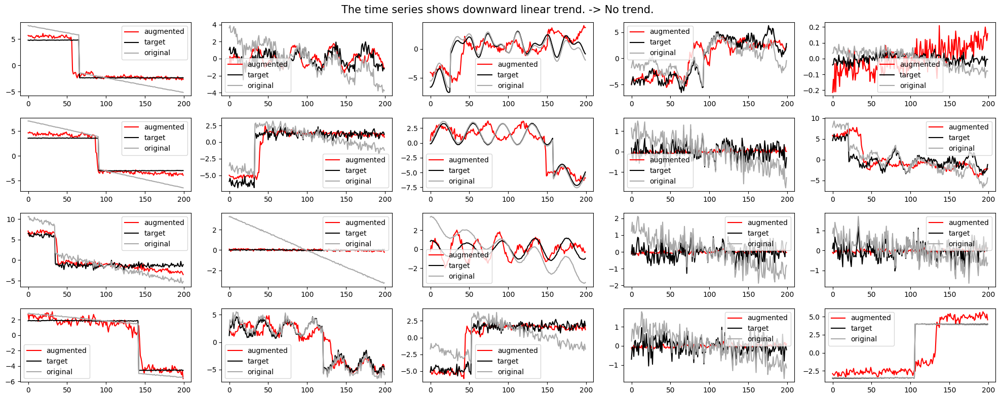

Similarity: 100%|██████████| 40000/40000 [00:18<00:00, 2188.14it/s]


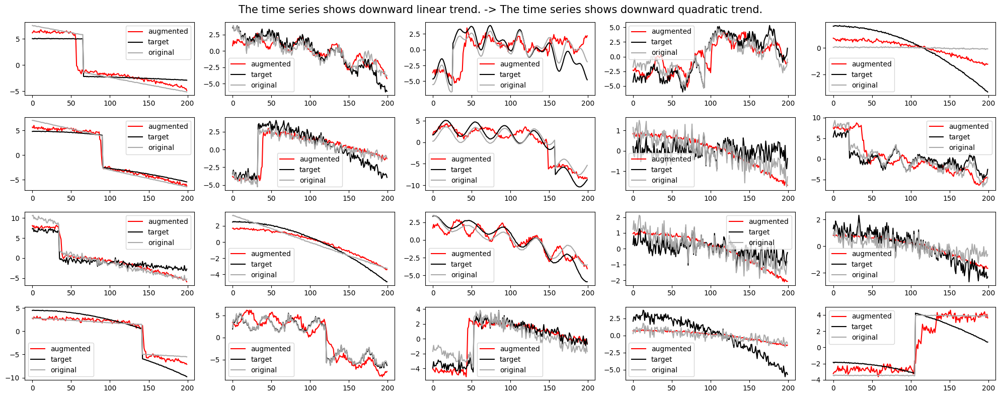

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2284.63it/s]


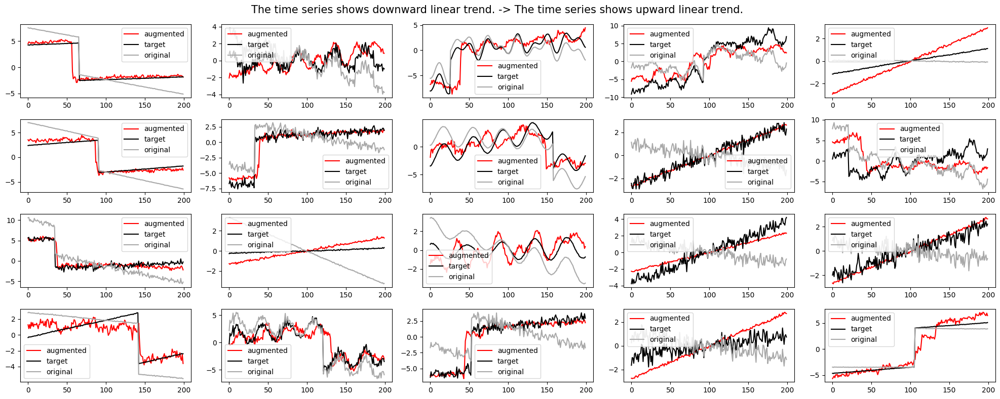

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2223.79it/s]


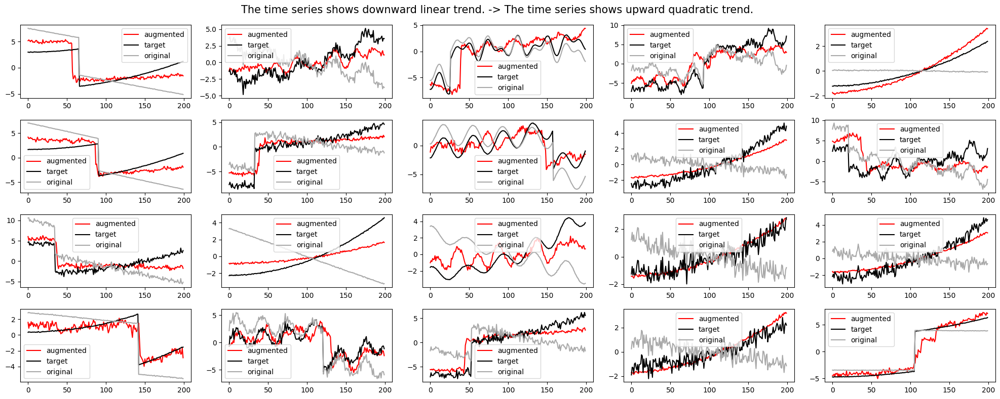

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2389.07it/s]


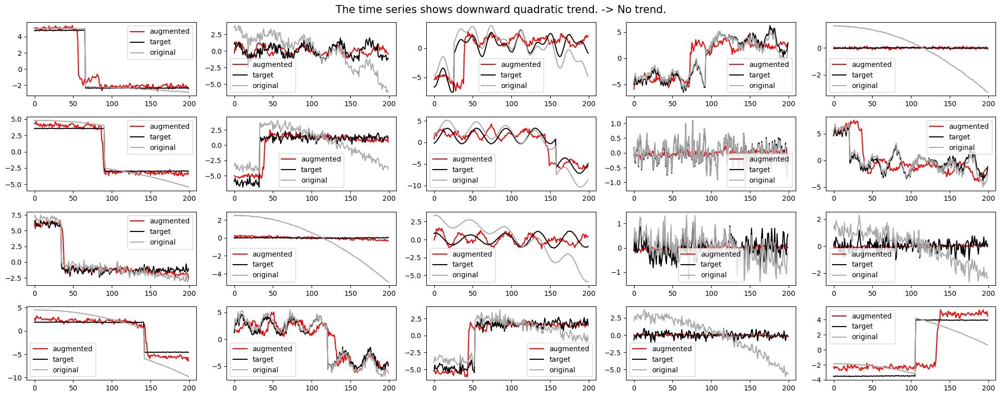

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2245.06it/s]


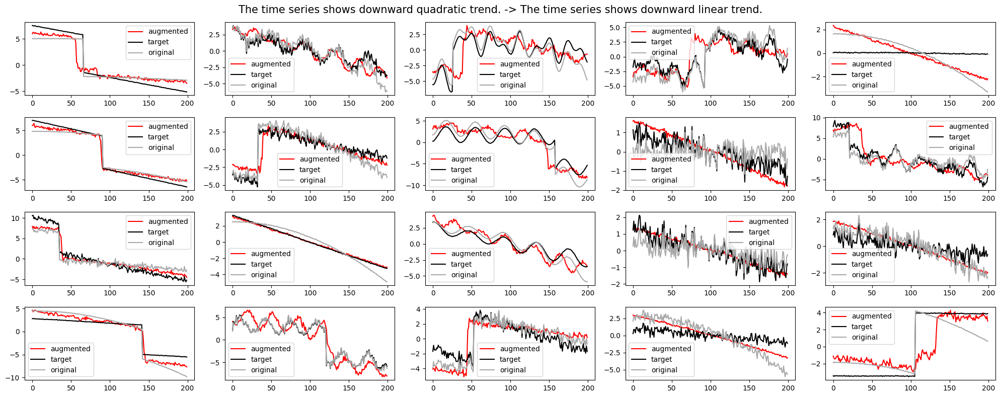

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2255.39it/s]


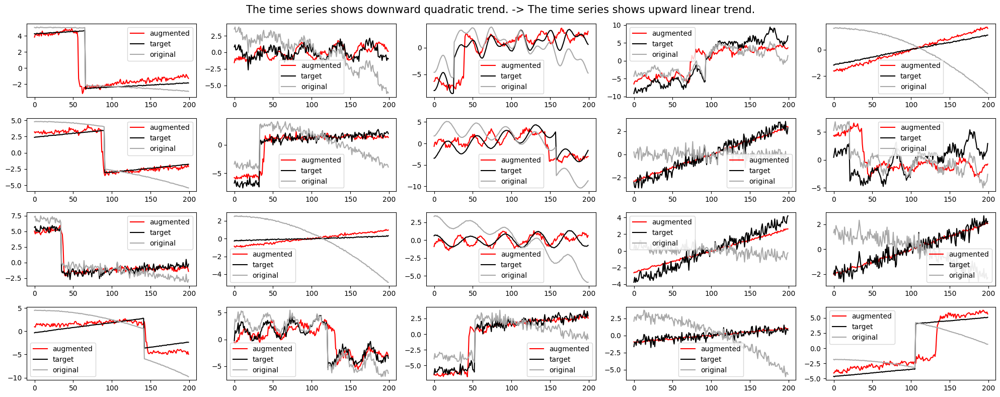

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2255.03it/s]


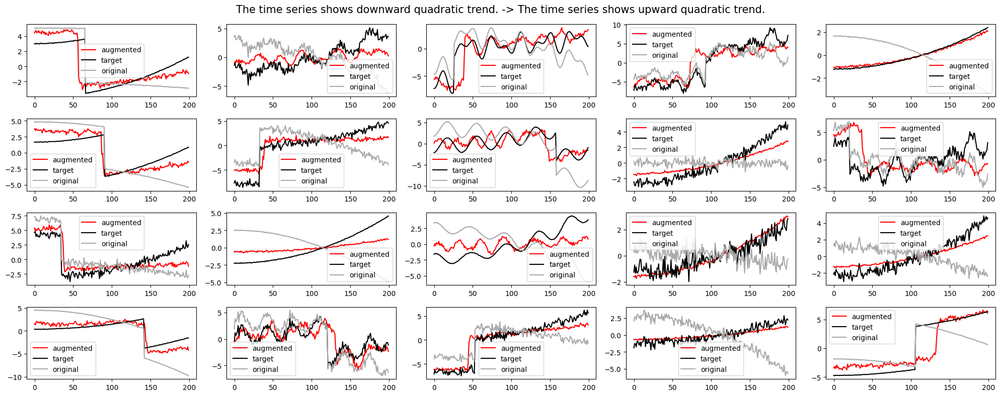

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2344.41it/s]


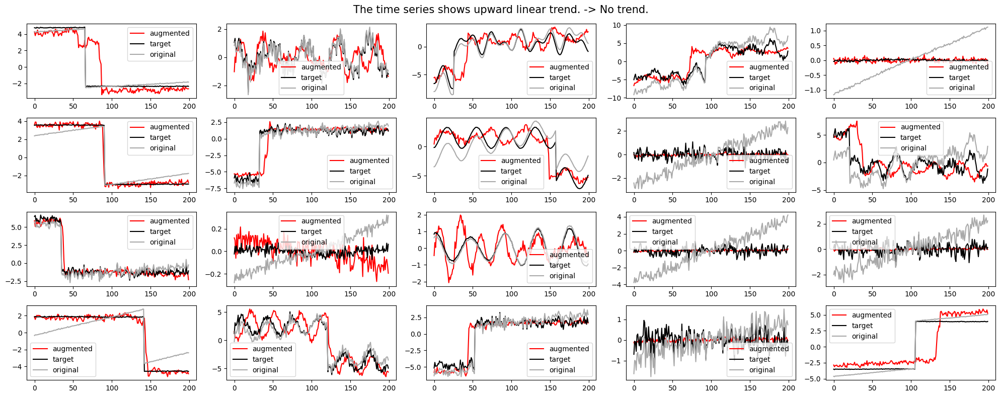

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2270.96it/s]


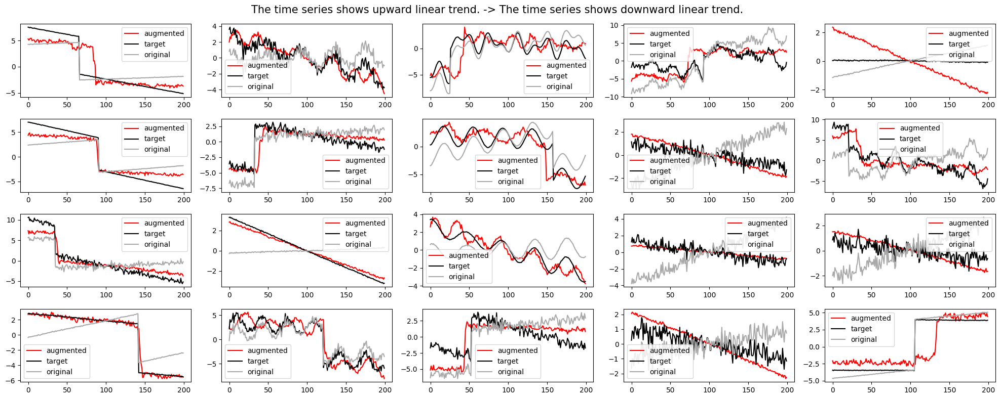

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2236.19it/s]


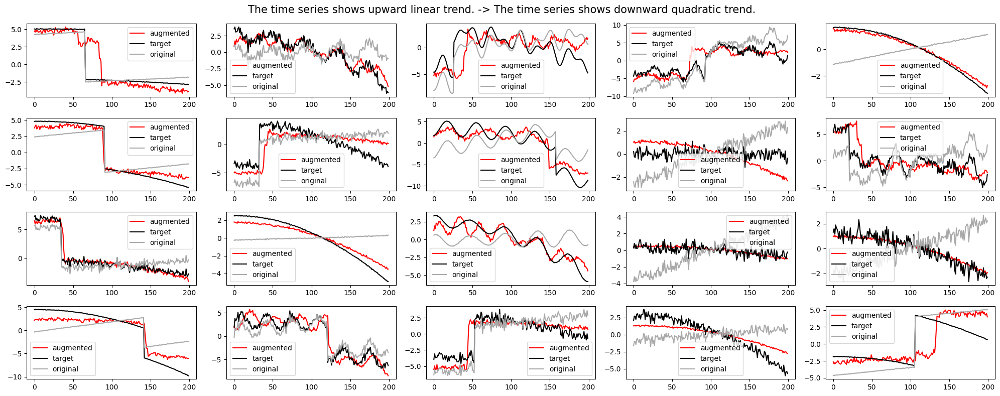

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2257.21it/s]


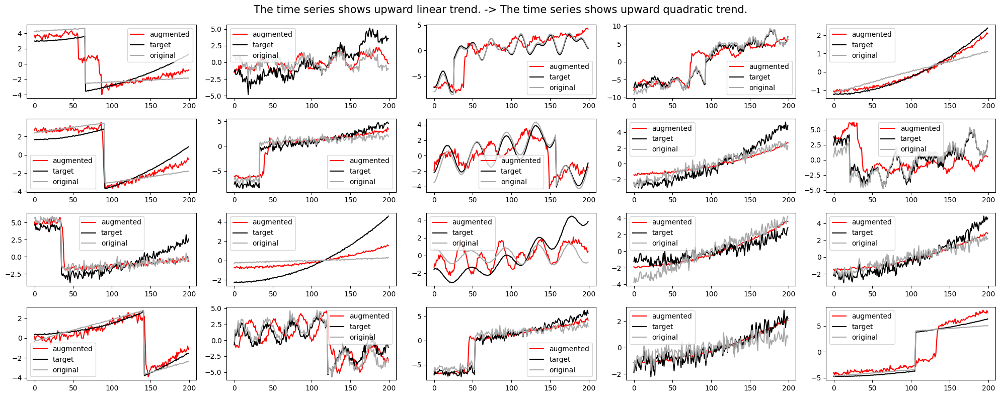

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2373.69it/s]


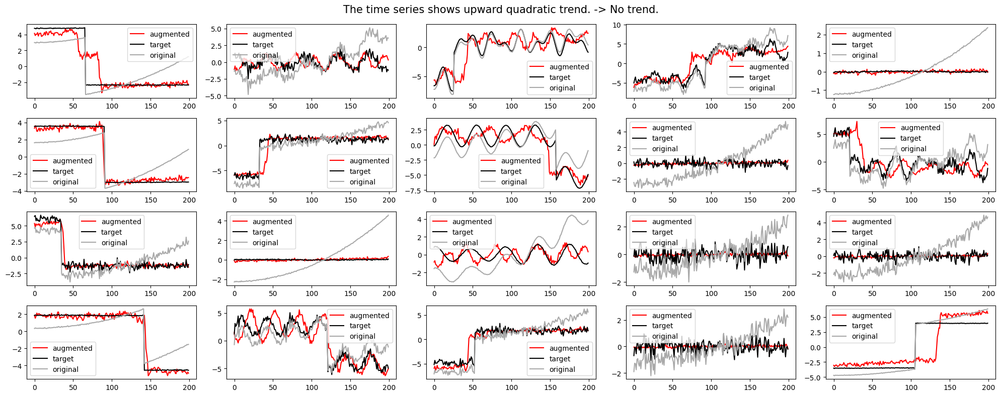

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2264.31it/s]


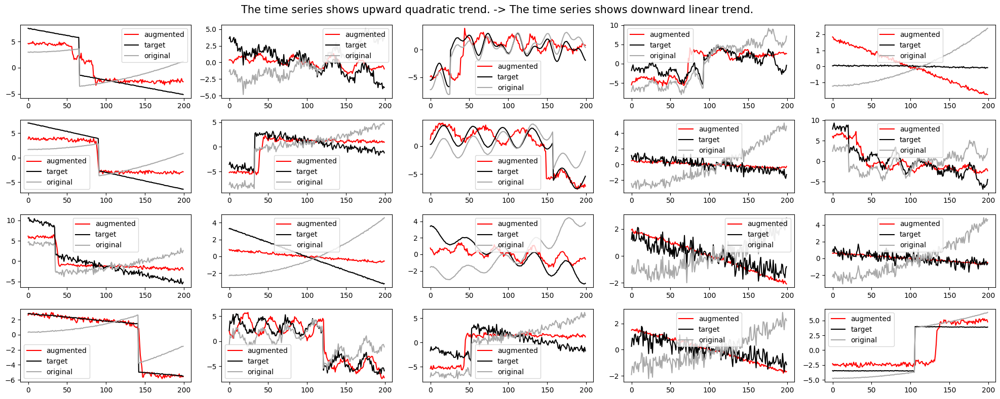

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2300.92it/s]


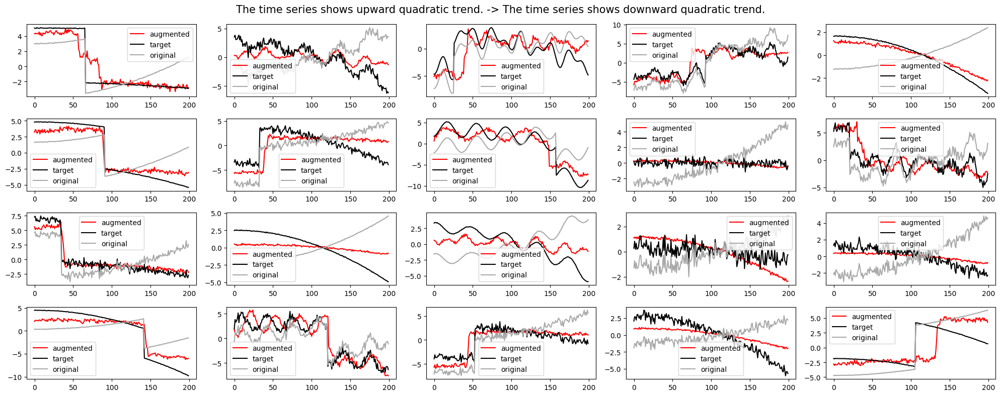

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2252.99it/s]


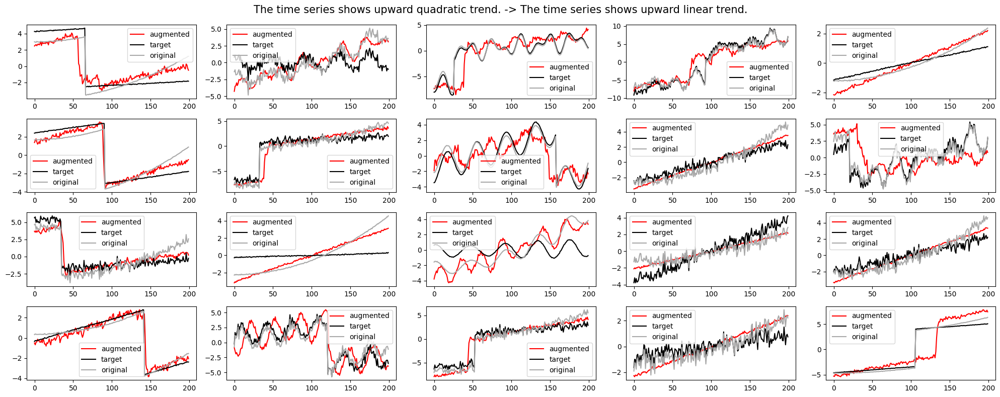

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2317.60it/s]


segment2


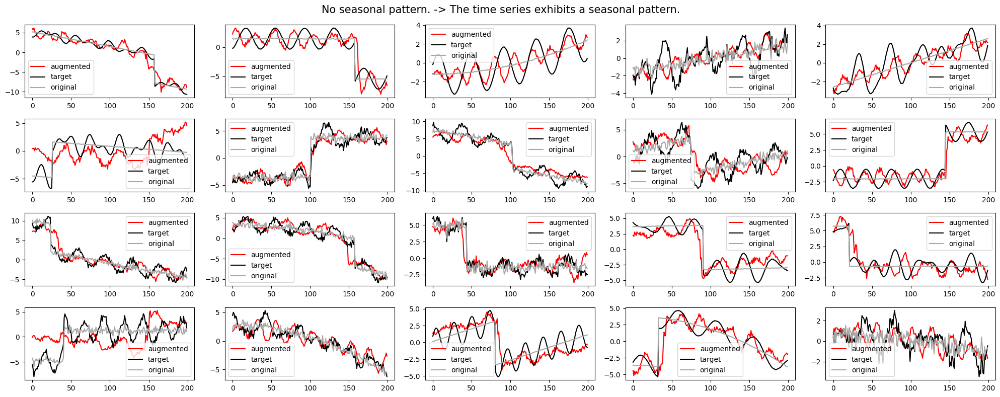

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2331.15it/s]


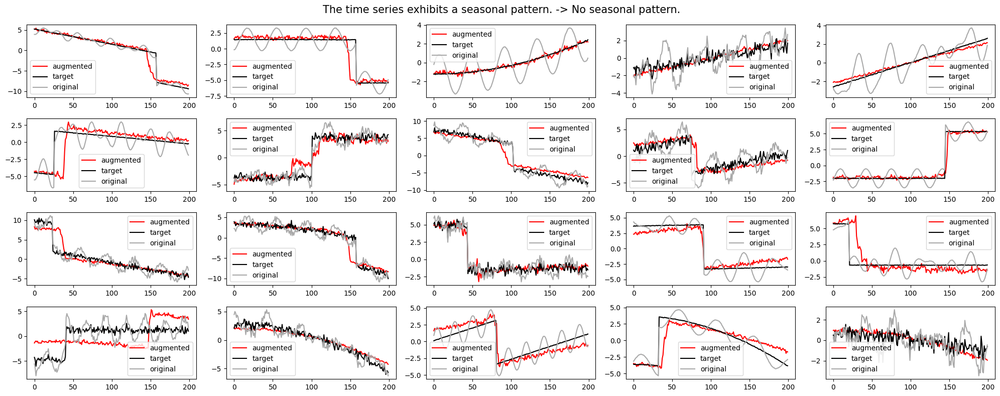

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2288.26it/s]


segment3


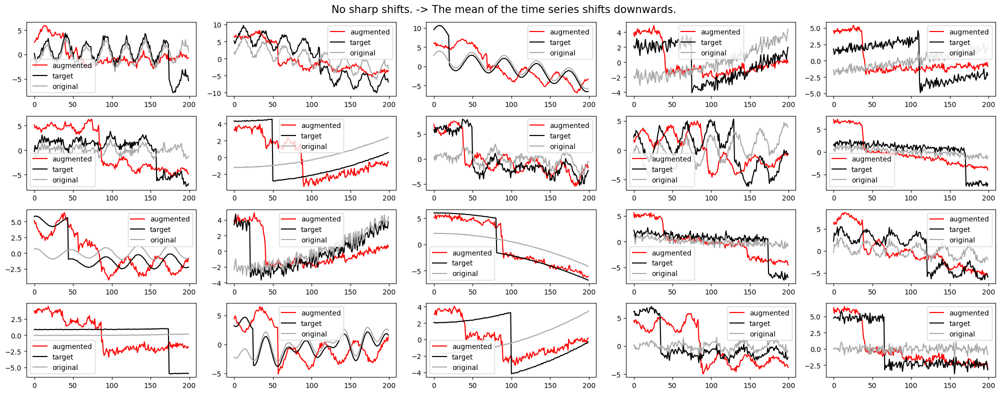

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2228.10it/s]


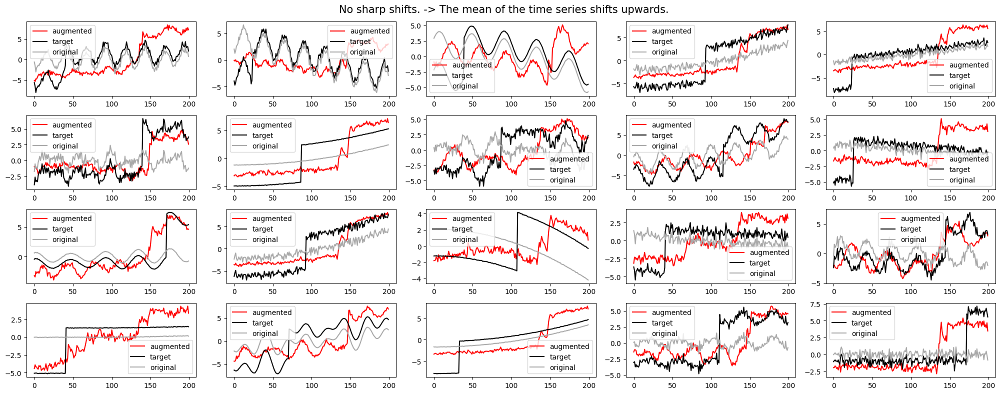

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2340.63it/s]


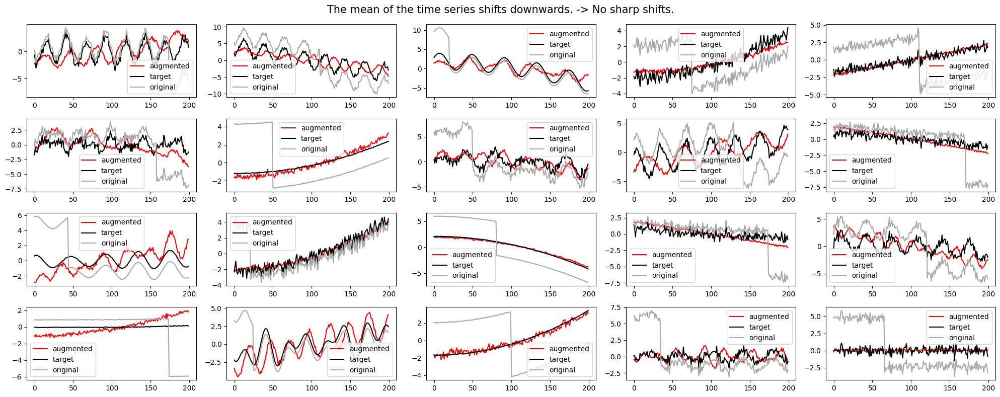

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2305.60it/s]


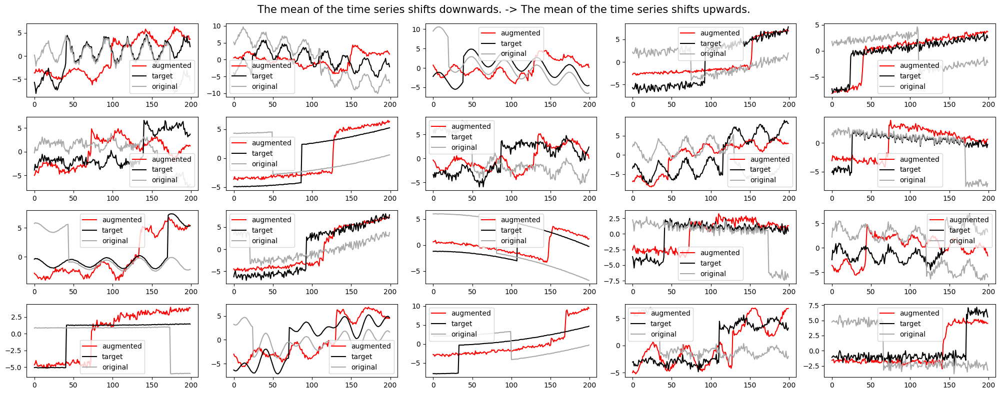

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2306.25it/s]


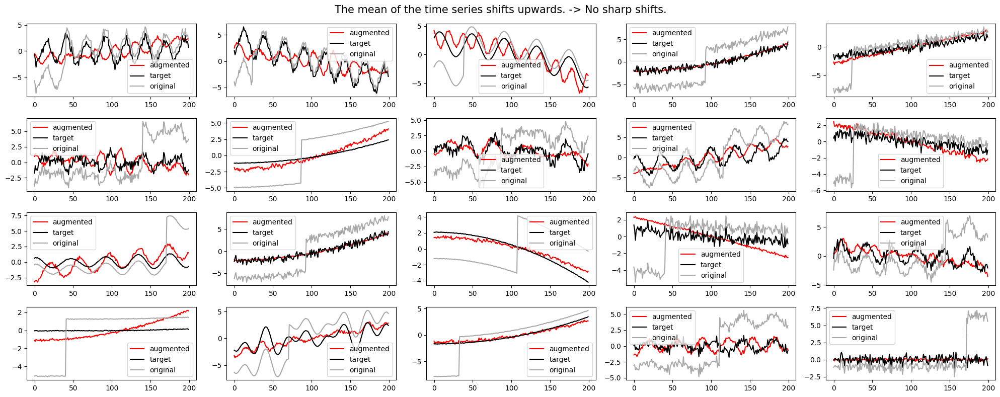

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2227.68it/s]


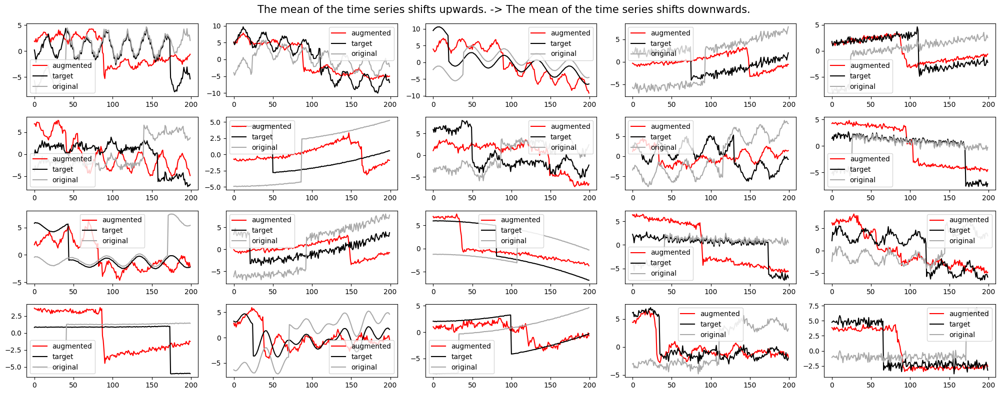

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2339.60it/s]


segment4


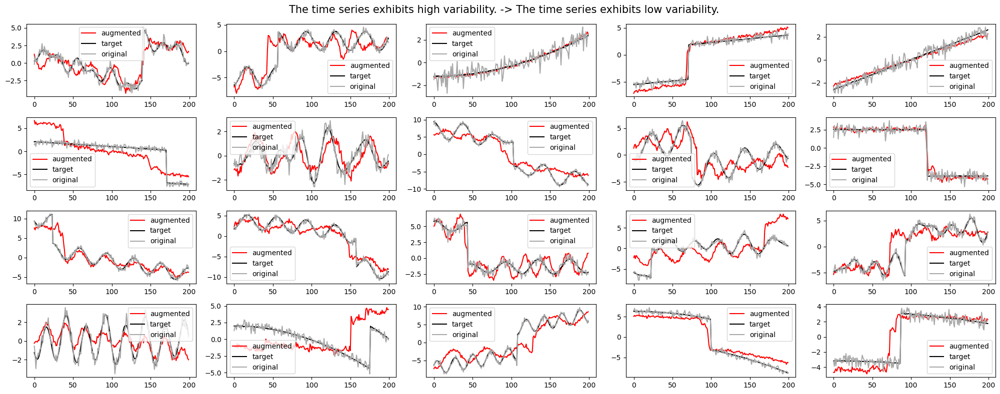

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2343.62it/s]


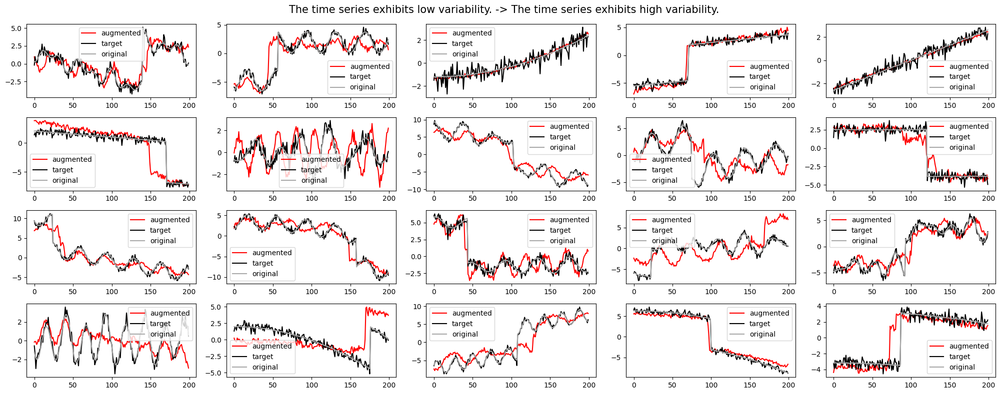

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2297.75it/s]


segment1


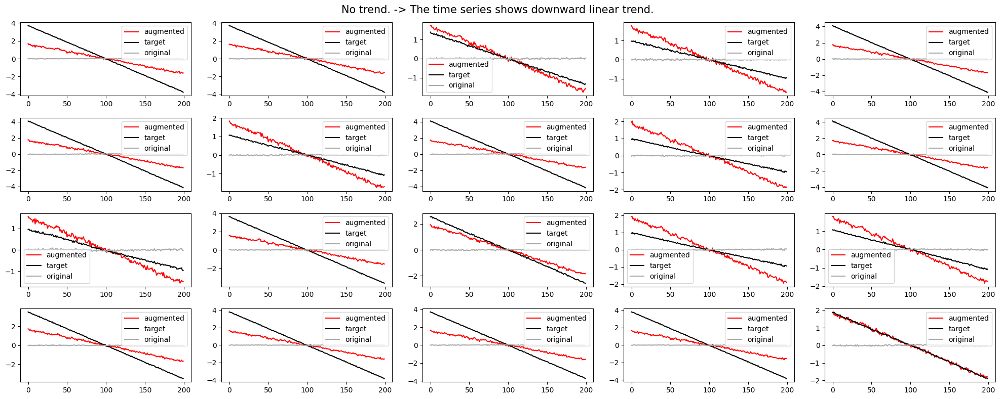

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2389.92it/s]


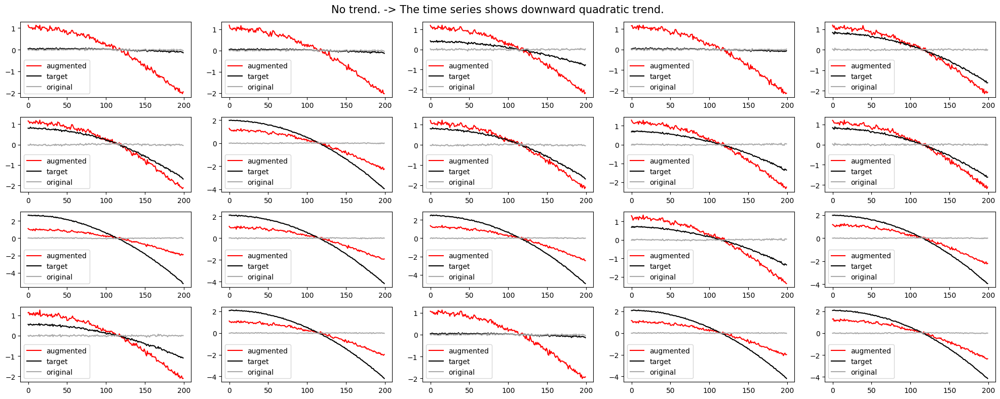

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2339.71it/s]


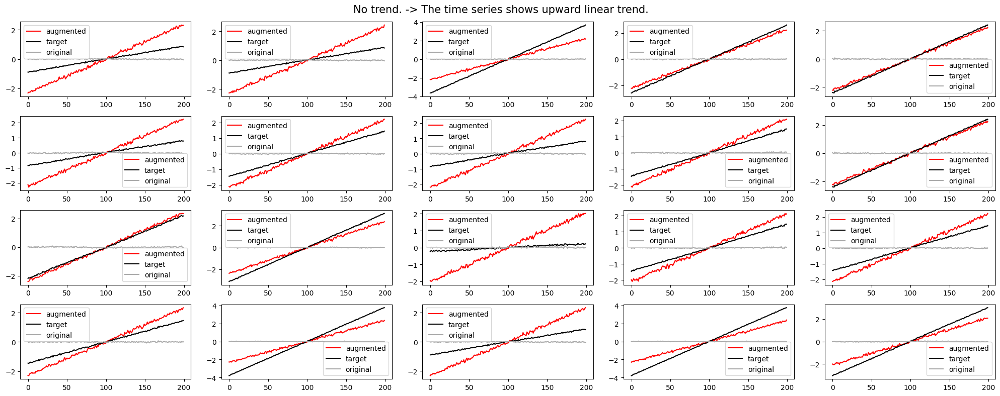

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2372.29it/s]


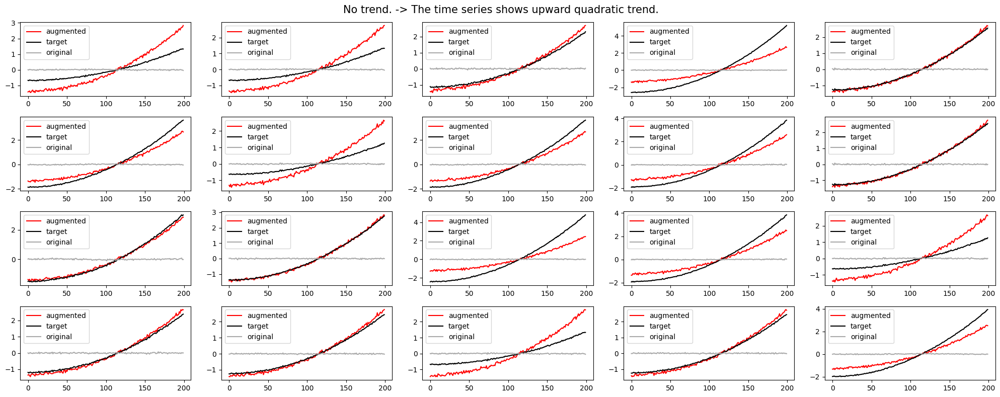

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2382.36it/s]


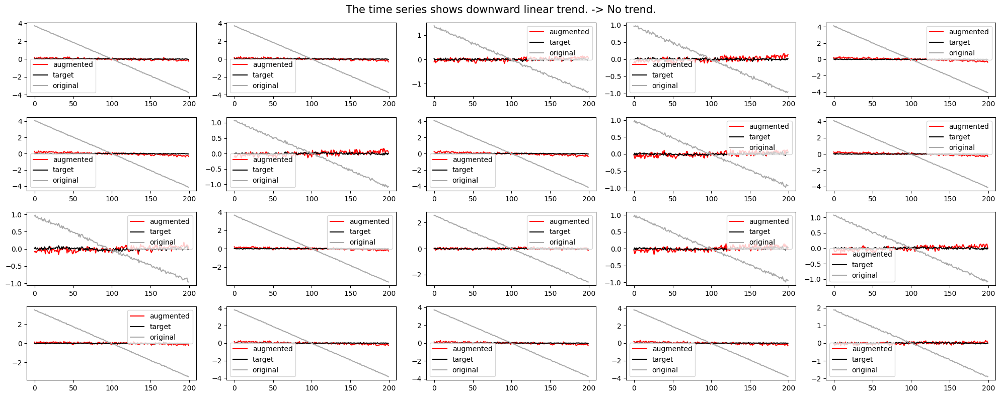

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2352.22it/s]


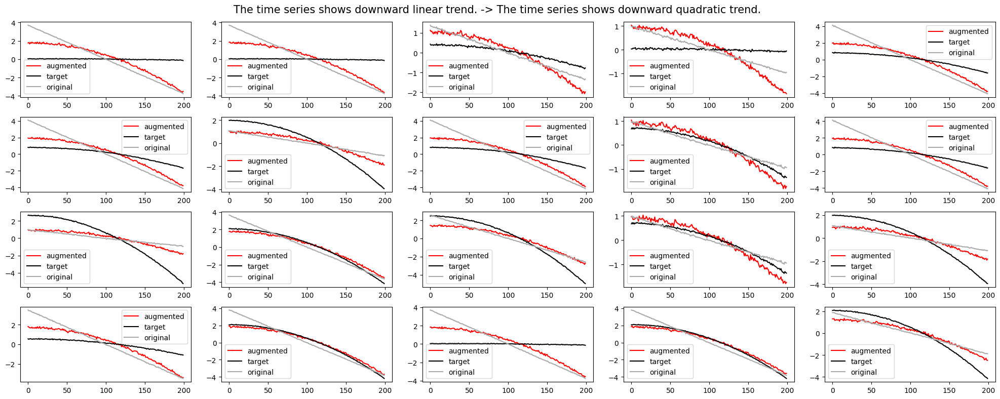

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2317.16it/s]


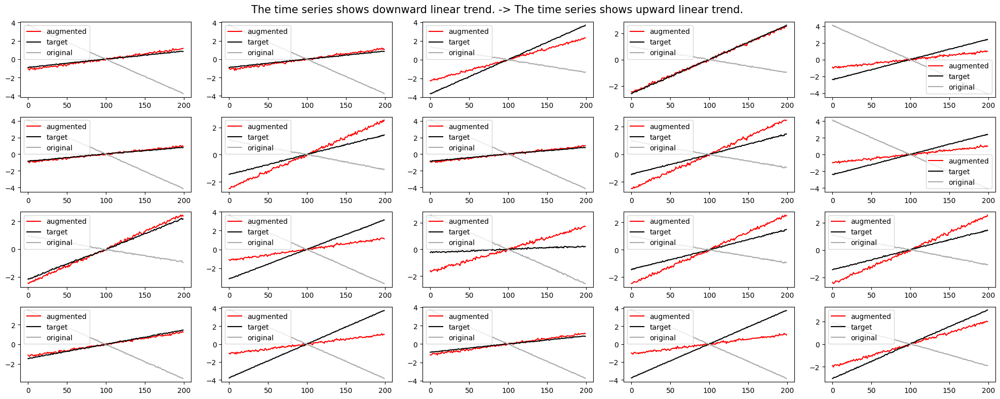

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2401.65it/s]


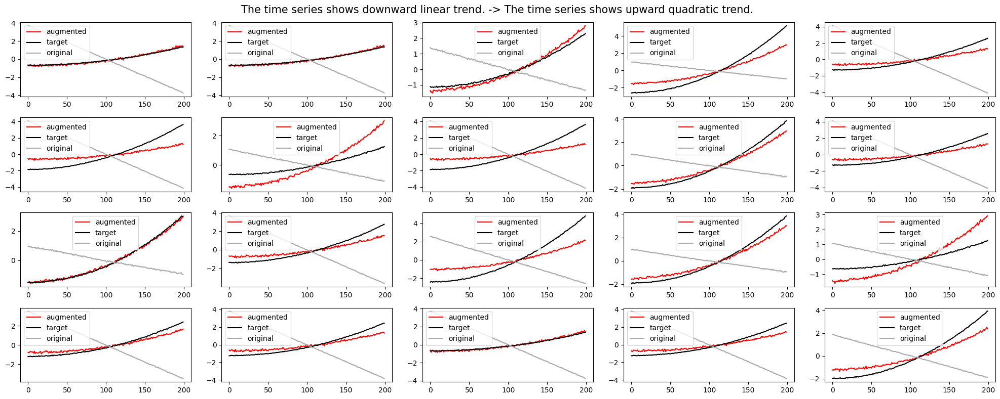

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2407.42it/s]


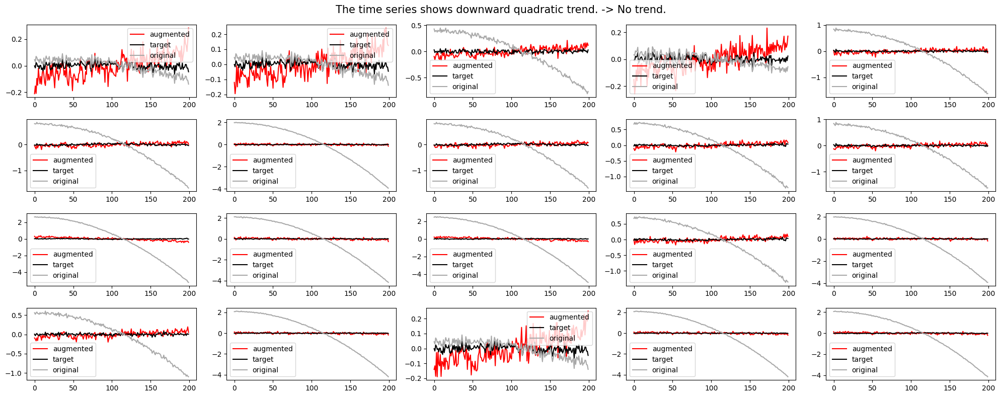

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2348.81it/s]


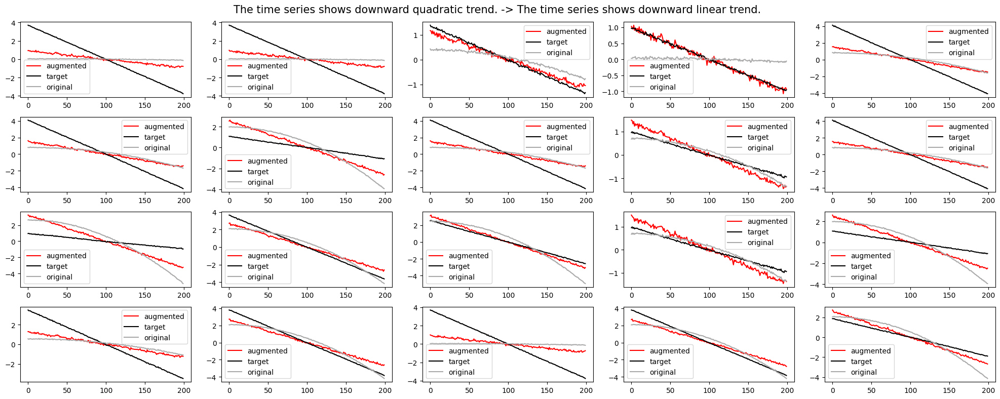

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2303.40it/s]


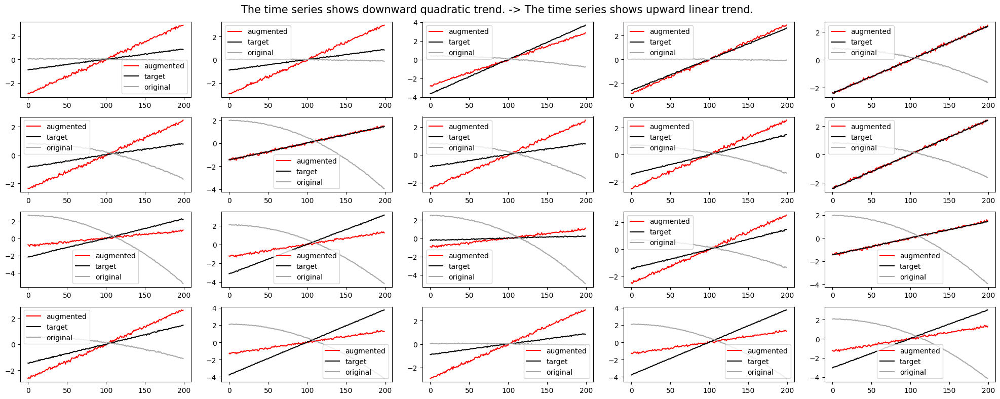

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2315.70it/s]


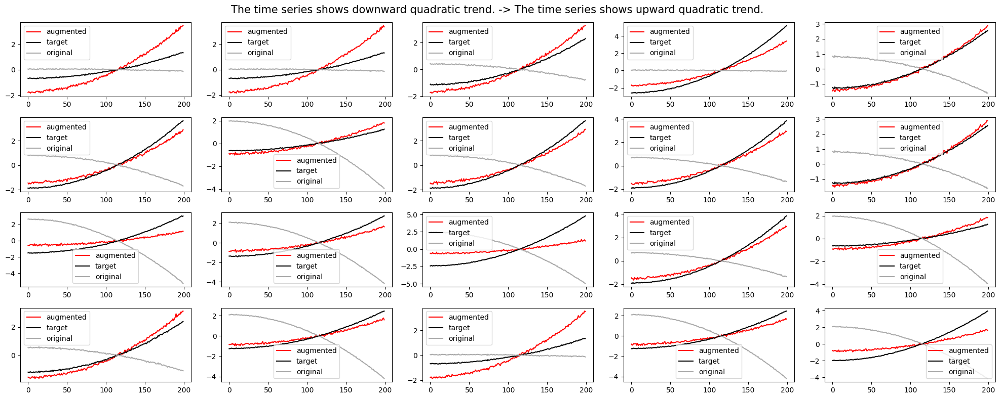

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2343.80it/s]


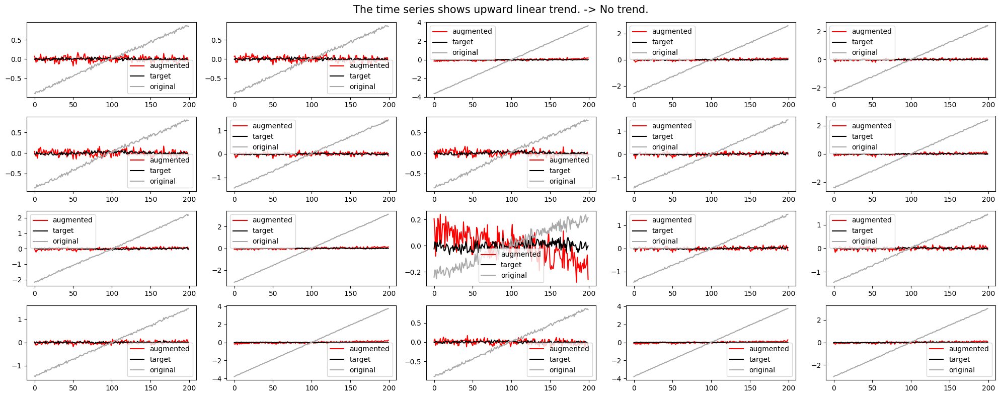

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2378.23it/s]


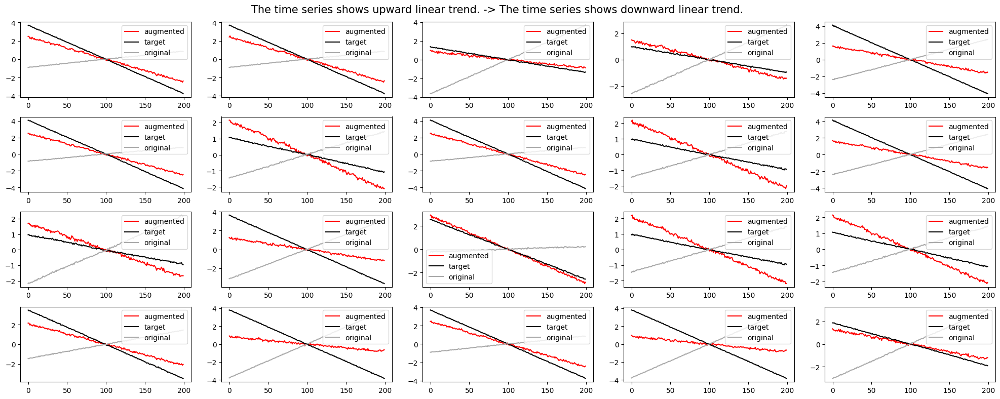

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2320.83it/s]


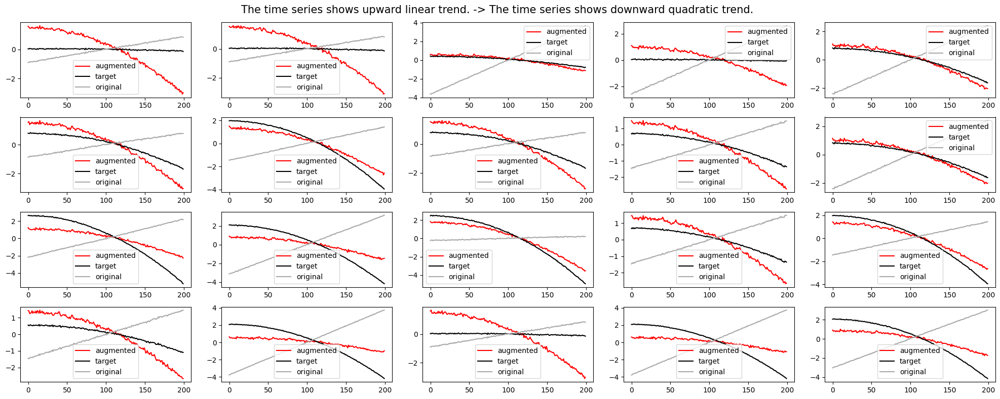

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2320.58it/s]


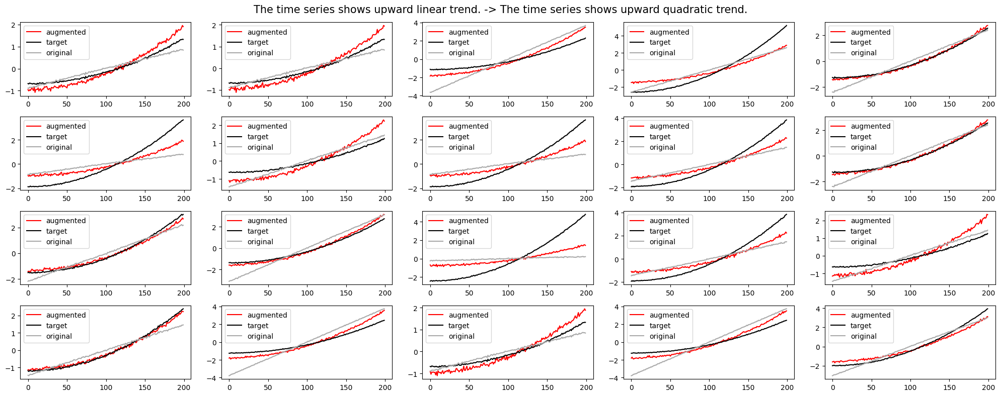

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2367.74it/s]


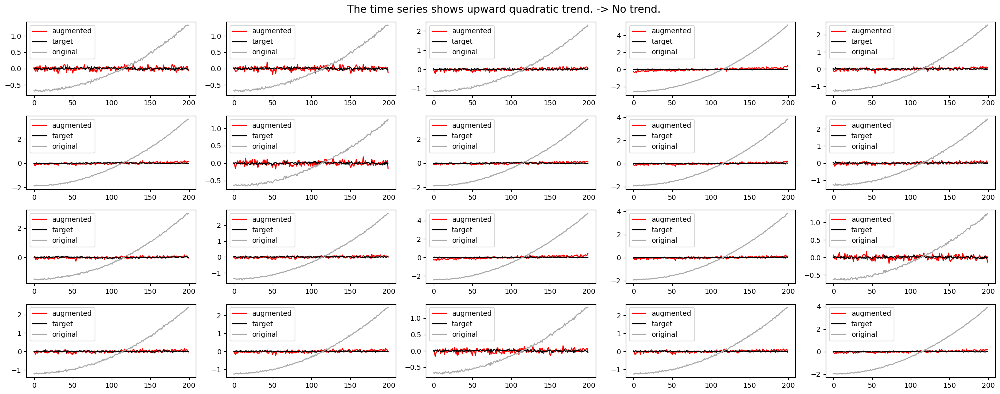

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2379.29it/s]


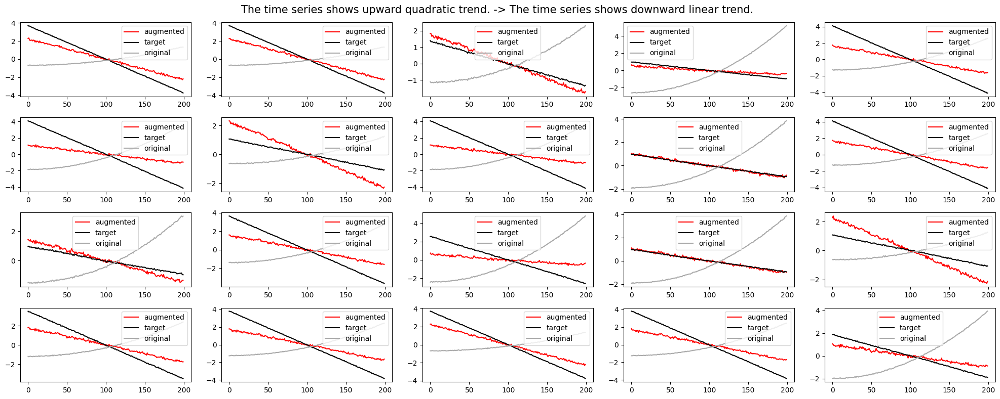

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2343.89it/s]


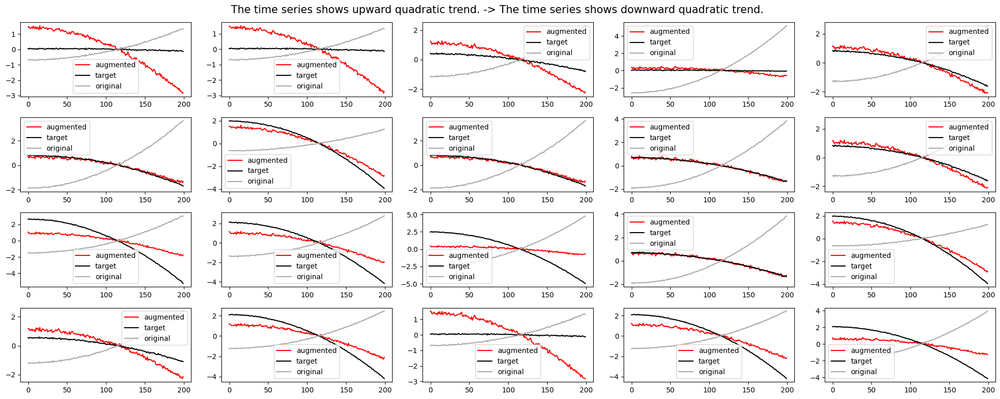

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2327.47it/s]


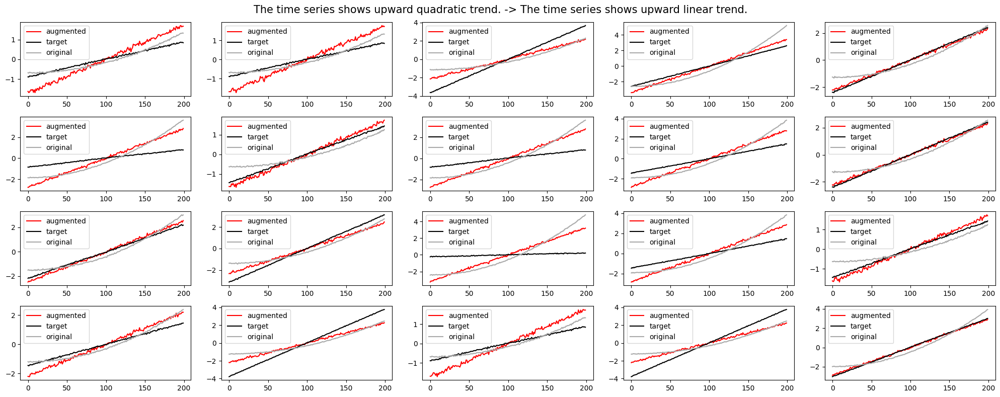

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2370.02it/s]


segment2


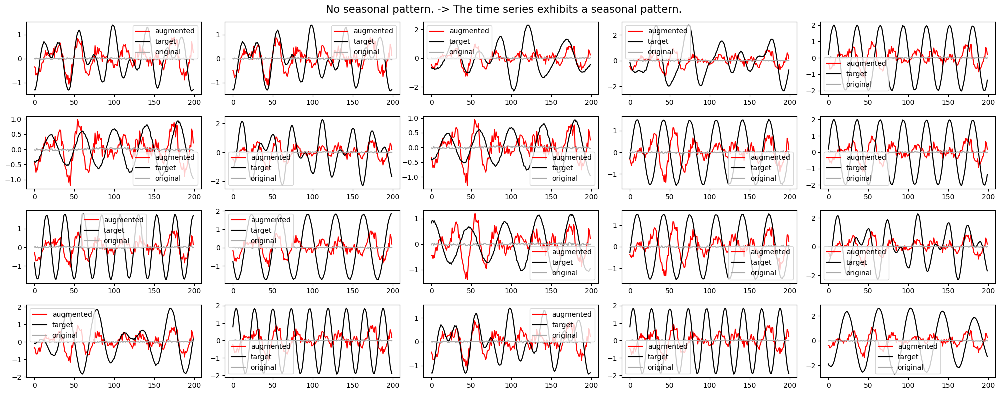

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2380.81it/s]


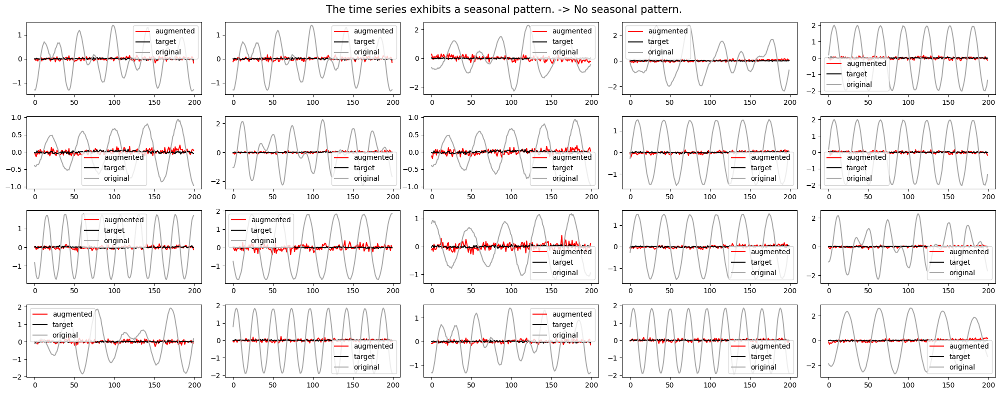

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2330.00it/s]


segment3


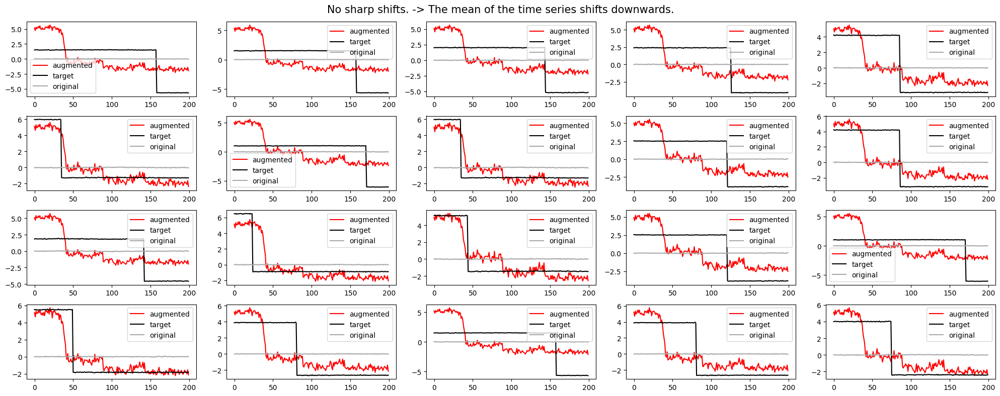

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2371.77it/s]


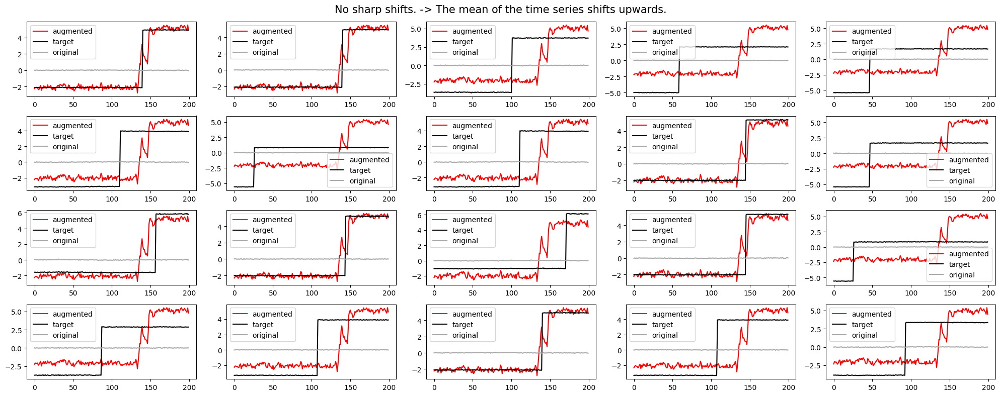

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2333.61it/s]


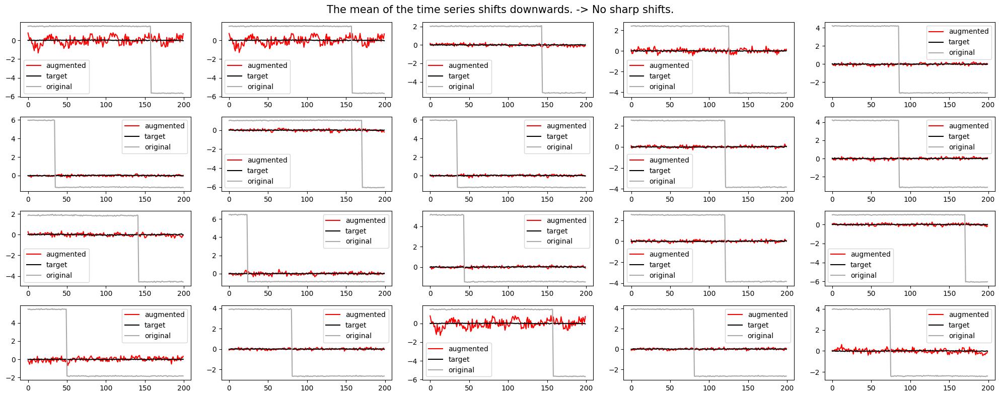

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2418.09it/s]


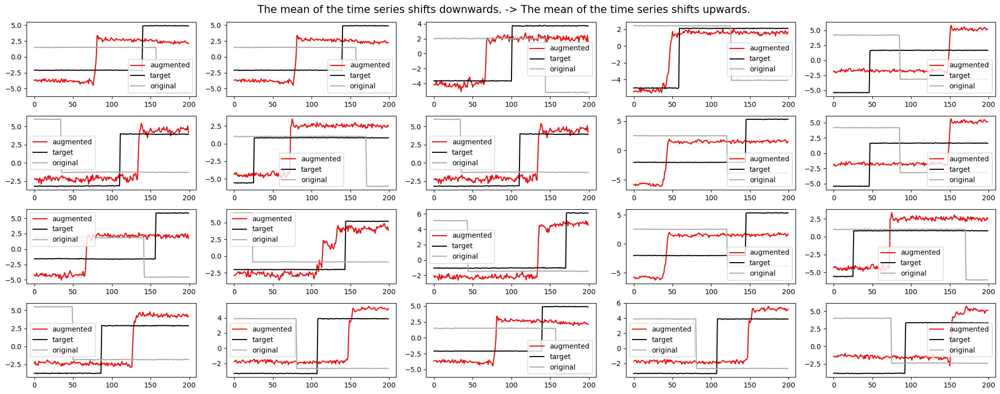

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2305.49it/s]


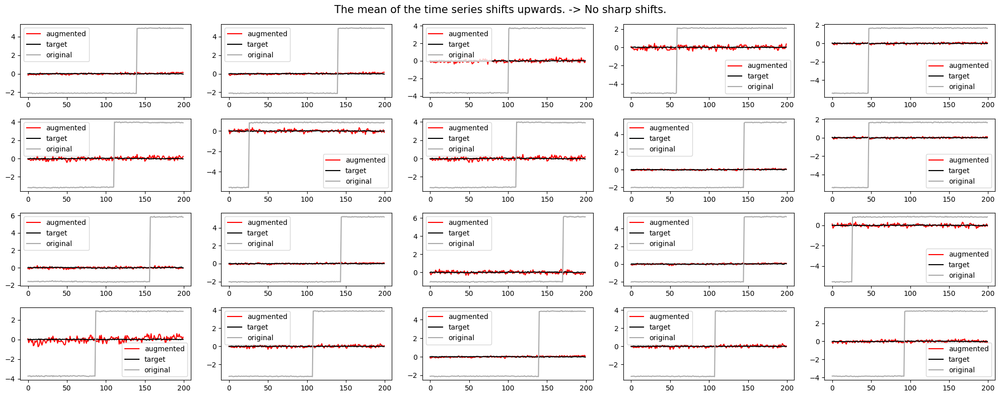

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2391.21it/s]


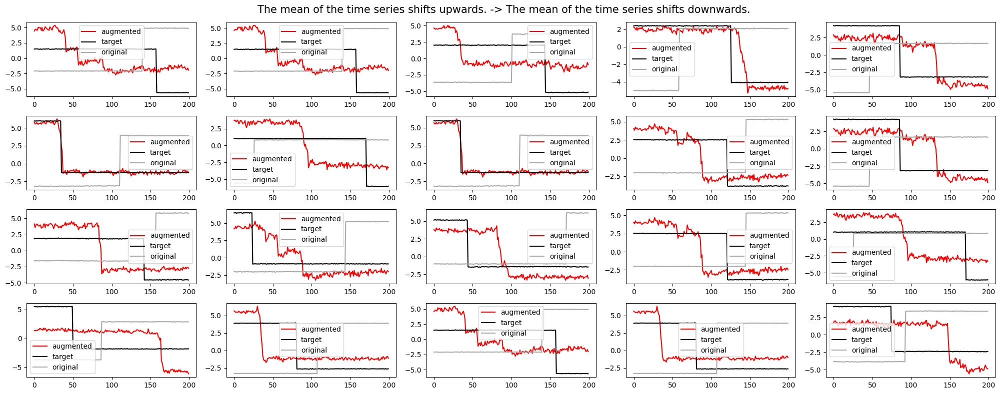

Similarity: 100%|██████████| 40000/40000 [00:17<00:00, 2300.82it/s]


segment4


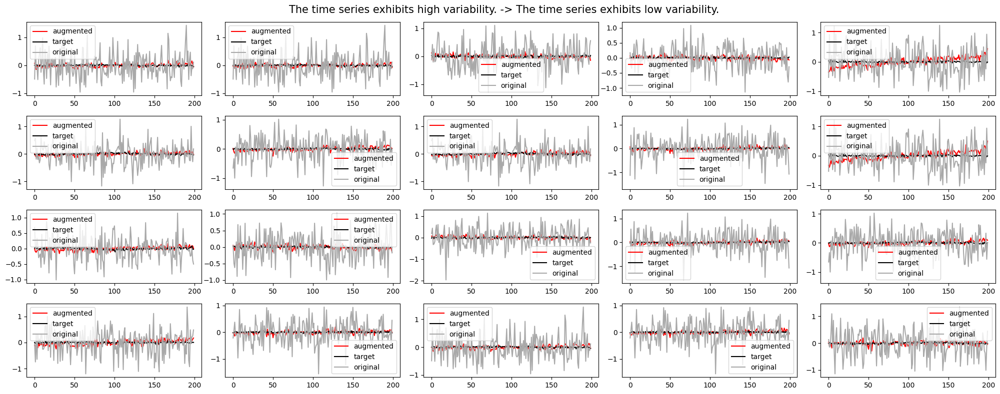

Similarity: 100%|██████████| 40000/40000 [00:16<00:00, 2380.61it/s]


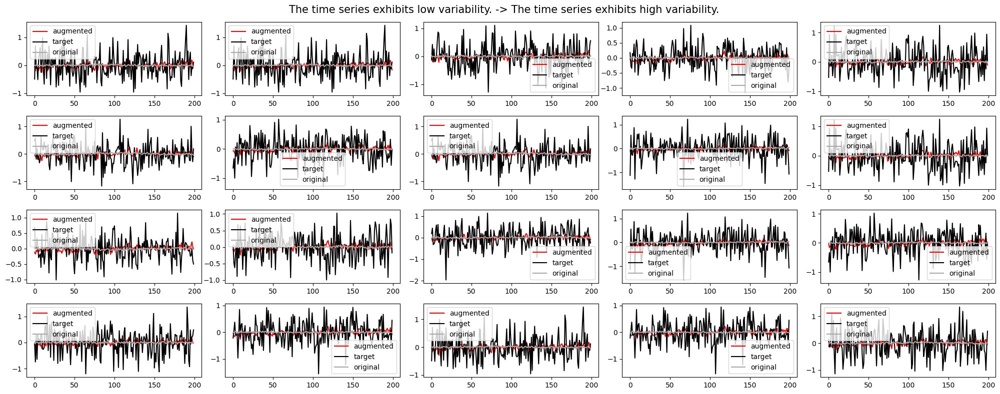

 13%|█▎        | 1288/10000 [01:01<06:53, 21.05it/s]


Early stopping at epoch 1289


 16%|█▌        | 1613/10000 [01:18<06:48, 20.52it/s]


Early stopping at epoch 1614


 99%|█████████▉| 9922/10000 [08:00<00:03, 20.66it/s]


Early stopping at epoch 9923


 64%|██████▍   | 6381/10000 [05:07<02:54, 20.72it/s]


Early stopping at epoch 6382


 56%|█████▌    | 5622/10000 [00:38<00:29, 146.87it/s]


Early stopping at epoch 5623


100%|██████████| 10000/10000 [00:57<00:00, 172.71it/s]


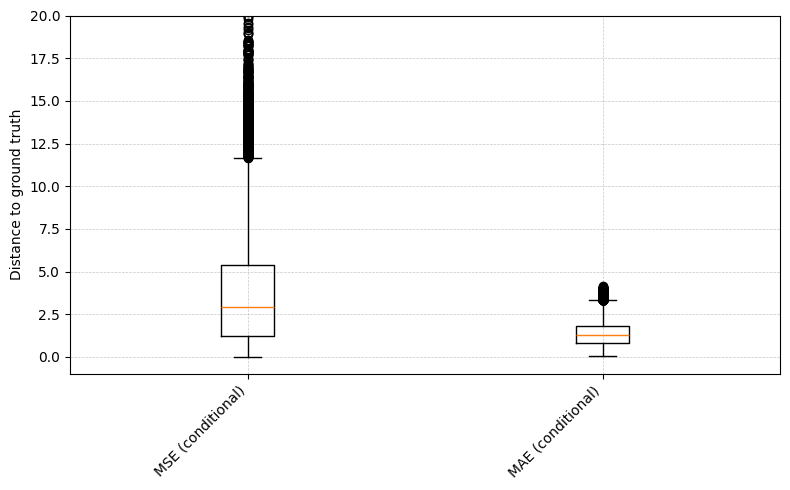

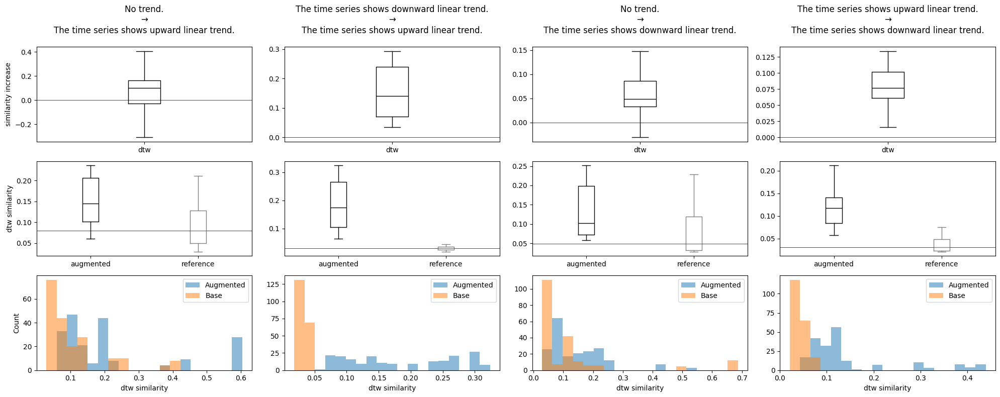

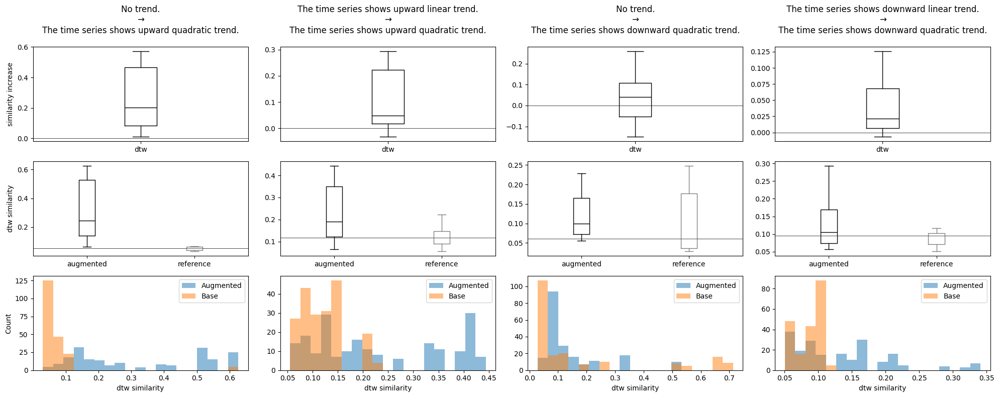

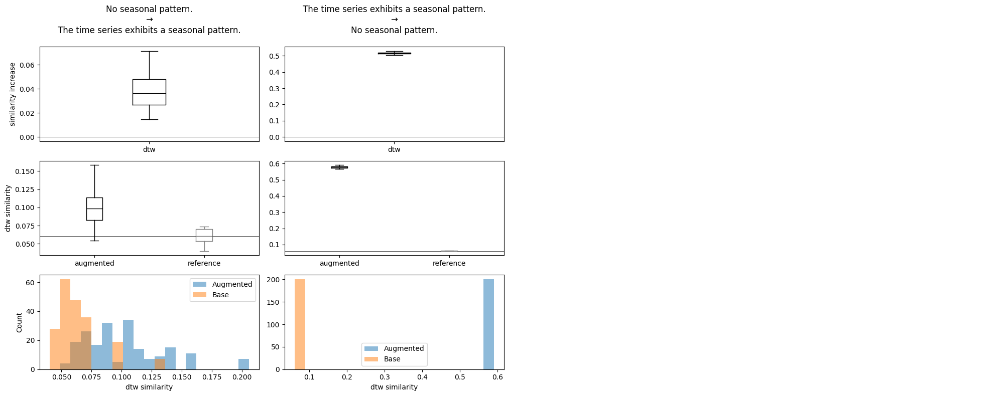

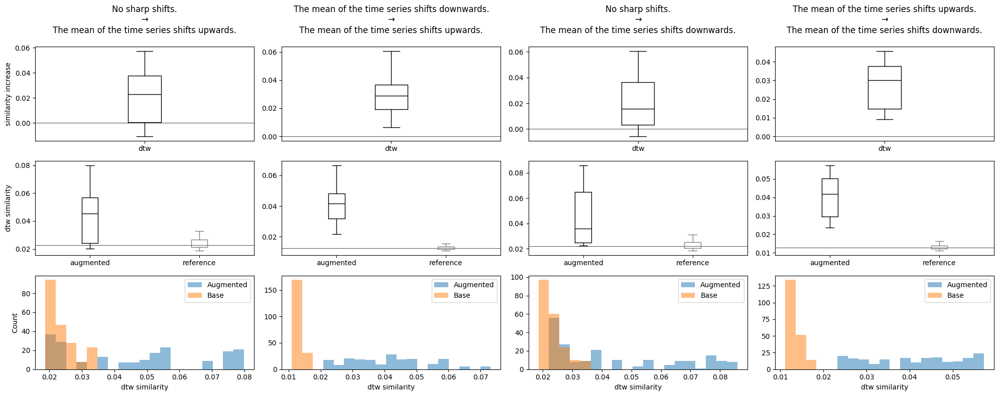

...

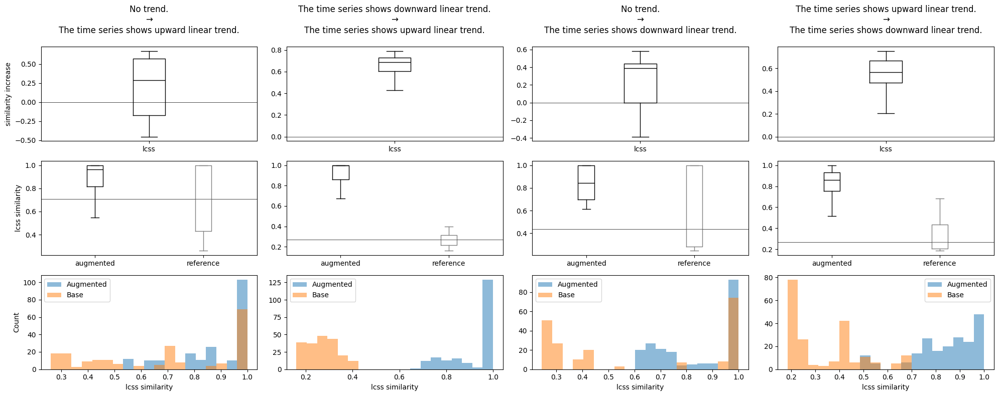

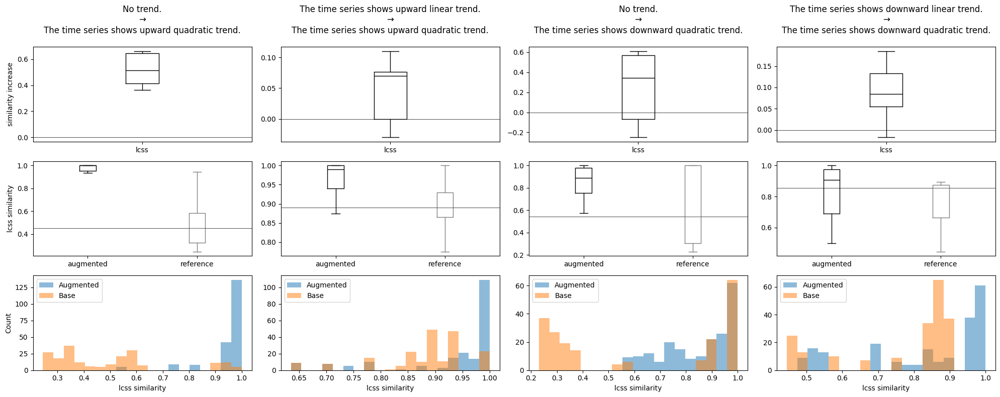

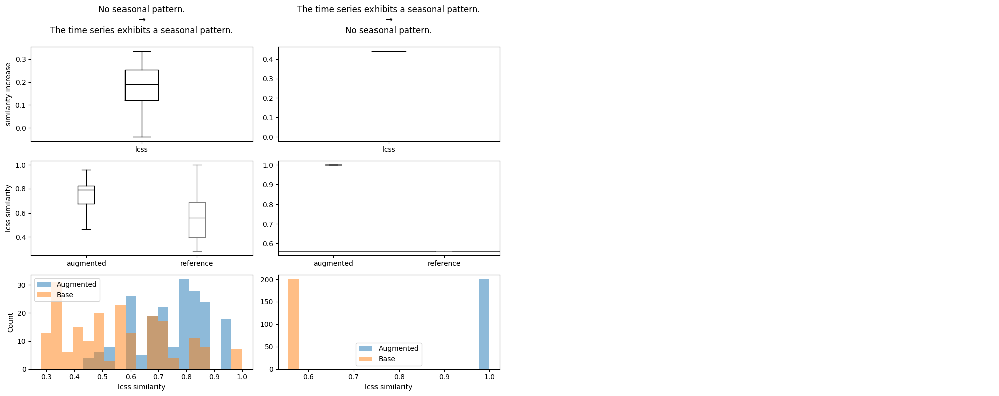

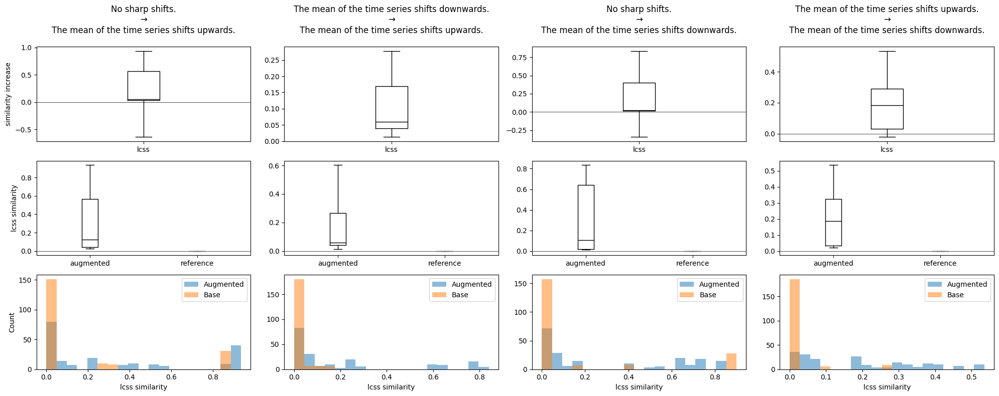

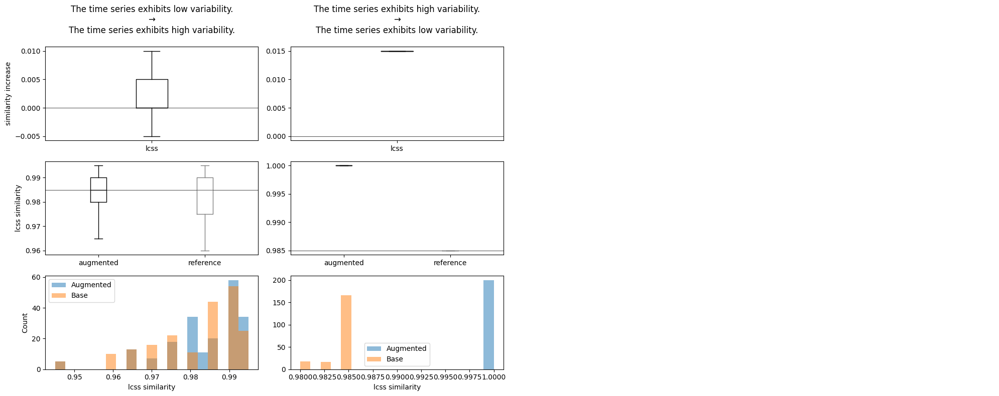

--------------------------------------------------------------------------------


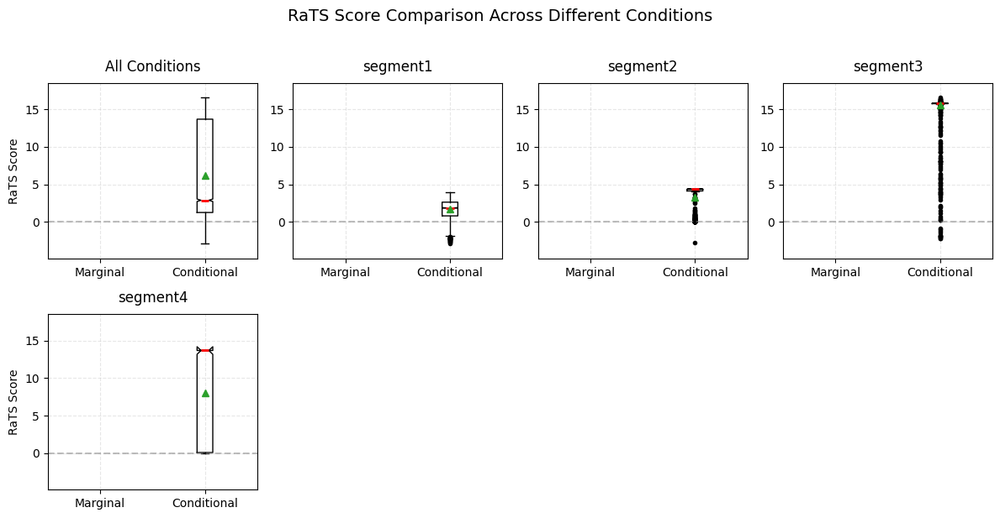

In [18]:
w = 0.6
with open('run/eval.py', 'r') as file:
    exec(file.read())
with open('run/eng_eval.py', 'r') as file:
    exec(file.read())

In [19]:
df_all = pd.concat([df_rats_all, df_dists_all, df_pw_dists_all], ignore_index=True).dropna(subset=['score'])
summarize_scores(df_all)

metric,Point-wise MSE ↓,Point-wise MAE ↓,DTW similarity improvement ↑,LCSS similarity improvement ↑,RaTS ↑
final_score,"2.90 [1.21, 5.40]","1.29 [0.79, 1.80]","0.05 [0.01, 0.19]","0.14 [0.01, 0.46]","2.87 [1.24, 13.69]"
